# Báo cáo Phân loại Tôm sử dụng YOLOv8

**Ngày tạo:** 15 tháng 5, 2025
**Người thực hiện:** [Điền tên của bạn vào đây]

## 1. Giới thiệu (Introduction)

### 1.1. Mô tả bài toán
Trong ngành nuôi trồng và chế biến thủy sản, việc phân loại chính xác các loại tôm đóng vai trò quan trọng để đảm bảo chất lượng sản phẩm, tối ưu hóa quy trình và đáp ứng nhu cầu thị trường. Việc phân loại thủ công thường tốn thời gian, chi phí nhân công cao và có thể không đồng nhất. Do đó, việc ứng dụng các mô hình học sâu như YOLOv8 để tự động hóa quá trình này mang lại nhiều tiềm năng, giúp tăng hiệu quả và độ chính xác.
Bài toán đặt ra là xây dựng một hệ thống có khả năng phát hiện và phân loại các giống tôm khác nhau dựa trên hình ảnh đầu vào, cụ thể là các giống tôm được định nghĩa trong bộ dữ liệu cung cấp.

### 1.2. Bộ dữ liệu
Bộ dữ liệu được sử dụng cho nghiên cứu này được mô tả trong tệp `data.yaml`. Dữ liệu bao gồm hình ảnh của nhiều loại tôm khác nhau, được chia thành các tập huấn luyện (train), kiểm định (validation) và kiểm thử (test). Mỗi hình ảnh được gán nhãn với các bounding box xác định vị trí của tôm và lớp (loại tôm) tương ứng. Thông tin chi tiết về các lớp và đường dẫn dữ liệu sẽ được khám phá trong phần tiếp theo.

### 1.3. Mục tiêu
Mục tiêu chính của báo cáo này bao gồm:
- Tiền xử lý và chuẩn bị bộ dữ liệu hình ảnh tôm cho việc huấn luyện mô hình YOLOv8.
- Huấn luyện một mô hình YOLOv8 để phát hiện và phân loại các loại tôm đã định nghĩa.
- Đánh giá hiệu suất của mô hình đã huấn luyện bằng các chỉ số tiêu chuẩn như Precision, Recall, mAP.
- Phân tích kết quả, thảo luận về những ưu điểm, hạn chế của mô hình và đề xuất các hướng cải thiện.
- Chuẩn bị mô hình đã huấn luyện để có thể tích hợp vào các ứng dụng nhận diện và phân loại tôm trong thực tế.

### 1.4. Giới thiệu YOLOv8
YOLOv8 (You Only Look Once version 8) là thế hệ mới nhất trong dòng mô hình phát hiện đối tượng YOLO, được phát triển bởi Ultralytics. YOLOv8 nổi bật với kiến trúc cải tiến, mang lại sự cân bằng tốt hơn giữa tốc độ và độ chính xác so với các phiên bản trước. Các ưu điểm chính của YOLOv8 bao gồm:
- **Hiệu suất cao:** Đạt được độ chính xác cao trên các bộ dữ liệu tiêu chuẩn trong khi vẫn duy trì tốc độ phát hiện nhanh, phù hợp cho các ứng dụng thời gian thực.
- **Linh hoạt:** Cung cấp nhiều biến thể mô hình (từ nano `n` đến extra-large `x`) cho phép người dùng lựa chọn tùy theo yêu cầu về tốc độ và độ chính xác cũng như tài nguyên phần cứng.
- **Dễ sử dụng:** Giao diện lập trình ứng dụng (API) thân thiện, dễ dàng huấn luyện, kiểm định và triển khai mô hình.
- **Hỗ trợ đa tác vụ:** Ngoài phát hiện đối tượng, YOLOv8 còn hỗ trợ các tác vụ khác như phân đoạn đối tượng (segmentation) và phân loại hình ảnh (classification).

## 2. Nguyên vật liệu và Phương pháp (Materials and Methods)

### 2.1. Chuẩn bị Bộ dữ liệu (Dataset Preparation)

In [1]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 45.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 7.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 31.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 13.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 8.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 89.1 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.9.41
    Uninstalling nvidia-nvjitlink-cu12-12.9.41:
      Successfully uninstalled nvidia-nvjitlink-cu12-12.9.41
  Attempting uninstall: nvidia-curand-cu12
    Found existing installation: nvidia-curand-cu12 10.3.10.19
    Uninstalling nvidia-curand-cu12-10.3

In [2]:
import os
import yaml
import cv2
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
from ultralytics import YOLO
import torch # Để kiểm tra GPU
from IPython.display import display # Để hiển thị ảnh trong notebook tốt hơn

# Tắt các cảnh báo không cần thiết (tùy chọn)
import warnings
warnings.filterwarnings('ignore') 

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [3]:
# Đường dẫn tới file data.yaml
# Cập nhật đường dẫn này cho môi trường Kaggle
data_yaml_path = '/kaggle/input/datayami/data.yaml' 

data_config = None
train_images_path = None
val_images_path = None
test_images_path = None
class_names = []
num_classes = 0
dataset_base_path_absolute = ''

print(f"Đường dẫn tệp data.yaml: {data_yaml_path}")
print(f"Tệp data.yaml tồn tại: {os.path.exists(data_yaml_path)}")

try:
    with open(data_yaml_path, 'r', encoding='utf-8') as f: # Thêm encoding='utf-8'
        data_config = yaml.safe_load(f)
    
    if data_config:
        print("Thông tin từ data.yaml:")
        print(f"  Đường dẫn dataset (trong yaml): {data_config.get('path', 'Không có')}")
        print(f"  Thư mục train (trong yaml): {data_config.get('train', 'Không có')}")
        print(f"  Thư mục val (trong yaml): {data_config.get('val', 'Không có')}")
        print(f"  Thư mục test (trong yaml): {data_config.get('test', 'Không có')}")
        num_classes = data_config.get('nc', len(data_config.get('names', []))) # Ưu tiên 'nc' nếu có
        names_from_yaml = data_config.get('names', [])
        if isinstance(names_from_yaml, dict):
            # Sắp xếp tên lớp theo key (ID) để đảm bảo đúng thứ tự
            class_names = [names_from_yaml[i] for i in sorted(names_from_yaml.keys()) if i < num_classes]
        elif isinstance(names_from_yaml, list):
            class_names = names_from_yaml
        else:
            class_names = [] # Fallback to empty list if format is unexpected
        
        print(f"  Số lớp (nc): {num_classes}")
        print(f"  Tên các lớp (đã xử lý thành list): {class_names}")

        # Xây dựng đường dẫn tuyệt đối cho dataset
        dataset_base_path_relative = data_config.get('path', '.')
        if not os.path.isabs(dataset_base_path_relative):
            # Giả định 'path' trong yaml là tương đối so với thư mục chứa file yaml
            dataset_base_path_absolute = os.path.abspath(os.path.join(os.path.dirname(data_yaml_path), dataset_base_path_relative))
        else:
            dataset_base_path_absolute = dataset_base_path_relative
        print(f"  Đường dẫn dataset tuyệt đối tính toán: {dataset_base_path_absolute}")

        # Cập nhật lại các đường dẫn trong data_config để sử dụng đường dẫn tuyệt đối cho train/val/test
        # và đảm bảo chúng được xử lý đúng cách dù là tương đối hay tuyệt đối trong file yaml
        for key in ['train', 'val', 'test']:
            path_value = data_config.get(key)
            if path_value: # Nếu key tồn tại và có giá trị
                if not os.path.isabs(path_value):
                    # Nếu đường dẫn là tương đối, nó được coi là tương đối so với dataset_base_path_absolute
                    data_config[key] = os.path.join(dataset_base_path_absolute, path_value)
                # Nếu đã là tuyệt đối thì giữ nguyên data_config[key]
                print(f"  Đường dẫn {key} tuyệt đối cuối cùng: {data_config[key]}")
            else:
                print(f"  Không có cấu hình cho '{key}' trong data.yaml.")

        train_images_path = data_config.get('train')
        val_images_path = data_config.get('val')
        test_images_path = data_config.get('test')
        
        # Kiểm tra sự tồn tại của các thư mục này
        if train_images_path: print(f"Train images path exists: {os.path.exists(train_images_path)}")
        if val_images_path: print(f"Validation images path exists: {os.path.exists(val_images_path)}")
        if test_images_path: print(f"Test images path exists: {os.path.exists(test_images_path)}")
    else:
        print("LỖI: data_config là None sau khi đọc YAML.")

except FileNotFoundError:
    print(f"LỖI: Không tìm thấy tệp {data_yaml_path}")
    data_config = None
except Exception as e:
    print(f"LỖI khi đọc hoặc xử lý tệp YAML: {e}")
    data_config = None

Đường dẫn tệp data.yaml: /kaggle/input/datayami/data.yaml
Tệp data.yaml tồn tại: True
Thông tin từ data.yaml:
  Đường dẫn dataset (trong yaml): /kaggle/input/datatom
  Thư mục train (trong yaml): train/images
  Thư mục val (trong yaml): valid/images
  Thư mục test (trong yaml): test/images
  Số lớp (nc): 13
  Tên các lớp (đã xử lý thành list): ['Tôm đốm đen', 'Tôm sét xanh', 'Tôm pha lê đỏ đen', 'Tôm hổ họa tiết đen', 'Tôm vua khổng lồ đen', 'Tôm đồng cổ truyền', 'Tôm hổ mắt cam', 'Tôm gấu trúc đen', 'Tôm đốm đỏ', 'Tôm hổ gấu mèo', 'Tôm bóng mờ Mosura', 'Tôm hổ cam', 'Tôm vàng trắng']
  Đường dẫn dataset tuyệt đối tính toán: /kaggle/input/datatom
  Đường dẫn train tuyệt đối cuối cùng: /kaggle/input/datatom/train/images
  Đường dẫn val tuyệt đối cuối cùng: /kaggle/input/datatom/valid/images
  Đường dẫn test tuyệt đối cuối cùng: /kaggle/input/datatom/test/images
Train images path exists: True
Validation images path exists: True
Test images path exists: True


### 2.1.1. Cấu hình đường dẫn cho Kaggle

Khi chạy trên Kaggle, đảm bảo rằng:
1.  Bộ dữ liệu của bạn được tải lên và có sẵn tại `/kaggle/input/datatom/`.
2.  Tệp `data.yaml` nằm ở `/kaggle/input/datatom/data.yaml`.
3.  Nội dung của tệp `/kaggle/input/datatom/data.yaml` được cấu hình đúng với các đường dẫn tương đối trỏ đến các thư mục `train`, `valid`, `test` bên trong `/kaggle/input/datatom/`. Ví dụ:

    ```yaml
    path: /kaggle/input/datatom
    train: train/images
    val: valid/images
    test: test/images

    names: 
      0: ClassName1
      1: ClassName2
      # ... (tên các lớp của bạn)
    ```

Nội dung cell Python bên dưới sẽ được cập nhật để sử dụng đường dẫn `data.yaml` trên Kaggle.

#### Hiển thị ảnh mẫu

Hiển thị ảnh mẫu từ tập huấn luyện: /kaggle/input/datatom/train/images
Thư mục nhãn huấn luyện kiểm tra: /kaggle/input/datatom/train/labels, Tồn tại: True


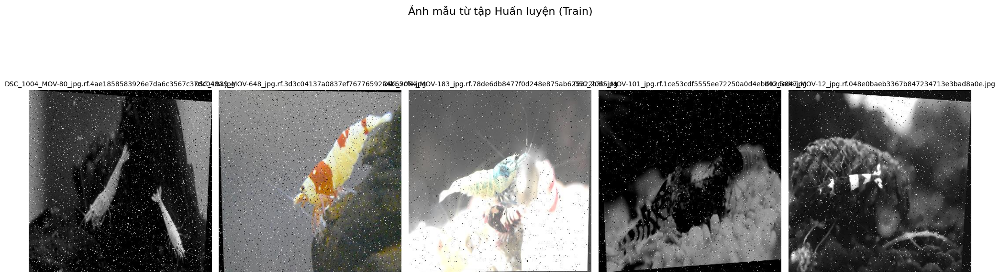

Hiển thị ảnh mẫu từ tập kiểm định: /kaggle/input/datatom/valid/images
Thư mục nhãn kiểm định kiểm tra: /kaggle/input/datatom/valid/labels, Tồn tại: True


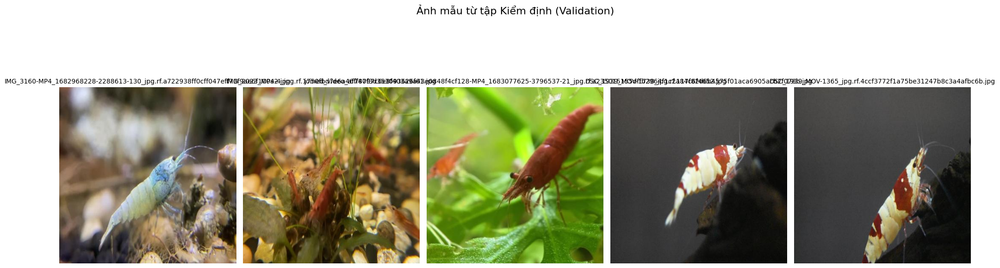

In [4]:
def display_sample_images_with_labels(image_folder_path, label_folder_path, num_samples=5, title="Sample Images with Labels", class_names_list=None):
    if not image_folder_path or not os.path.exists(image_folder_path):
        print(f"Thư mục ảnh không tồn tại: {image_folder_path}" )
        return
    if not label_folder_path or not os.path.exists(label_folder_path):
        print(f"Thư mục nhãn không tồn tại: {label_folder_path}" )
        # Hiển thị ảnh không có nhãn nếu thư mục nhãn không có
        display_sample_images(image_folder_path, num_samples, title.replace("with Labels", "(No Labels Found)"))
        return
    
    all_images_names = [img_name for img_name in os.listdir(image_folder_path) 
                      if img_name.lower().endswith(('.png', '.jpg', '.jpeg'))]
    
    if not all_images_names:
        print(f"Không tìm thấy ảnh nào trong: {image_folder_path}" )
        return

    sample_images_names = np.random.choice(all_images_names, min(num_samples, len(all_images_names)), replace=False)
    
    plt.figure(figsize=(20, 7 * ((len(sample_images_names) -1 ) // num_samples +1) )) # Điều chỉnh kích thước cho nhiều hàng nếu cần
    plt.suptitle(title, fontsize=16)
    
    processed_successfully_count = 0
    failed_processing_details = []

    for i, img_name in enumerate(sample_images_names):
        img_path = os.path.join(image_folder_path, img_name)
        label_file_name = os.path.splitext(img_name)[0] + '.txt'
        label_file_path = os.path.join(label_folder_path, label_file_name)
        
        try:
            img = Image.open(img_path).convert("RGB")
            img_cv = np.array(img) # Chuyển sang OpenCV format để vẽ box
            img_cv = cv2.cvtColor(img_cv, cv2.COLOR_RGB2BGR) # PIL là RGB, OpenCV là BGR
            h_img, w_img, _ = img_cv.shape
            
            if os.path.exists(label_file_path) and class_names_list:
                with open(label_file_path, 'r') as f_label:
                    for line in f_label.readlines():
                        parts = line.strip().split()
                        if len(parts) == 5: # class_id, x_center, y_center, width, height
                            class_id = int(parts[0])
                            x_center, y_center, box_width, box_height = map(float, parts[1:])
                            
                            x1 = int((x_center - box_width / 2) * w_img)
                            y1 = int((y_center - box_height / 2) * h_img)
                            x2 = int((x_center + box_width / 2) * w_img)
                            y2 = int((y_center + box_height / 2) * h_img)
                            
                            cv2.rectangle(img_cv, (x1, y1), (x2, y2), (0, 255, 0), 2) # Màu xanh lá, độ dày 2
                            if 0 <= class_id < len(class_names_list):
                                label_text = class_names_list[class_id]
                                cv2.putText(img_cv, label_text, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0,255,0), 2)
                            else:
                                cv2.putText(img_cv, f'ID:{class_id}', (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0,0,255), 2) # ID không hợp lệ màu đỏ
            
            plt.subplot( (len(sample_images_names) -1 ) // num_samples + 1 , num_samples, i + 1)
            plt.imshow(cv2.cvtColor(img_cv, cv2.COLOR_BGR2RGB)) # Chuyển lại RGB cho matplotlib
            plt.title(img_name, fontsize=10)
            plt.axis('off')
            processed_successfully_count +=1
        except Exception as e:
            failed_processing_details.append({'name': os.path.basename(img_path), 'error': str(e), 'type': type(e).__name__})

    if failed_processing_details:
        print(f"CẢNH BÁO: {len(failed_processing_details)}/{len(sample_images_names)} ảnh mẫu trong '{title}' gặp lỗi khi xử lý:")
        for item in failed_processing_details[:3]: # Hiển thị chi tiết cho 3 lỗi đầu
            print(f"  - Ảnh: {item['name']}, Lỗi: {item['type']} - {item['error']}")
        if len(failed_processing_details) > 3:
            print(f"  ... và {len(failed_processing_details) - 3} lỗi khác.")

    if processed_successfully_count == 0 and len(sample_images_names) > 0:
        print(f"Không có ảnh mẫu nào từ '{title}' được hiển thị thành công.")
    
    if processed_successfully_count > 0 : # Chỉ gọi tight_layout nếu có subplot được vẽ
        plt.tight_layout(rect=[0, 0, 1, 0.96]) 
    plt.show()

def display_sample_images(image_folder_path, num_samples=5, title="Sample Images"):
    # Hàm này dùng khi không có thư mục labels hoặc không cần hiển thị labels
    if not image_folder_path or not os.path.exists(image_folder_path):
        print(f"Thư mục ảnh không tồn tại: {image_folder_path}" )
        return
    all_images_names = [img_name for img_name in os.listdir(image_folder_path) 
                      if img_name.lower().endswith(('.png', '.jpg', '.jpeg'))]
    if not all_images_names: print(f"Không tìm thấy ảnh nào trong: {image_folder_path}" ); return
    
    sample_images_names = np.random.choice(all_images_names, min(num_samples, len(all_images_names)), replace=False)
    
    plt.figure(figsize=(15, 5)); plt.suptitle(title, fontsize=16)
    
    processed_successfully_count = 0
    failed_processing_details = []

    for i, img_name in enumerate(sample_images_names):
        img_path = os.path.join(image_folder_path, img_name)
        try:
            img = Image.open(img_path).convert("RGB")
            plt.subplot(1, num_samples, i + 1); plt.imshow(img); plt.title(img_name, fontsize=10); plt.axis('off')
            processed_successfully_count += 1
        except Exception as e: 
            failed_processing_details.append({'name': os.path.basename(img_path), 'error': str(e), 'type': type(e).__name__})

    if failed_processing_details:
        print(f"CẢNH BÁO: {len(failed_processing_details)}/{len(sample_images_names)} ảnh mẫu trong '{title}' gặp lỗi khi mở:")
        for item in failed_processing_details[:3]: # Hiển thị chi tiết cho 3 lỗi đầu
            print(f"  - Ảnh: {item['name']}, Lỗi: {item['type']} - {item['error']}")
        if len(failed_processing_details) > 3:
            print(f"  ... và {len(failed_processing_details) - 3} lỗi khác.")

    if processed_successfully_count == 0 and len(sample_images_names) > 0:
        print(f"Không có ảnh mẫu nào từ '{title}' được hiển thị thành công.")

    if processed_successfully_count > 0: # Chỉ gọi tight_layout nếu có subplot được vẽ
        plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()

# Hiển thị ảnh mẫu từ tập train và val (nếu đường dẫn tồn tại)
if data_config and class_names:
    # Tập Train
    if train_images_path and os.path.exists(train_images_path):
        train_labels_path = train_images_path.replace('images', 'labels', 1) # Thay thế 'images' bằng 'labels' một lần
        print(f"Hiển thị ảnh mẫu từ tập huấn luyện: {train_images_path}" )
        print(f"Thư mục nhãn huấn luyện kiểm tra: {train_labels_path}, Tồn tại: {os.path.exists(train_labels_path)}")
        display_sample_images_with_labels(train_images_path, train_labels_path, title="Ảnh mẫu từ tập Huấn luyện (Train)", class_names_list=class_names)
    else:
        print(f"Thư mục huấn luyện không tồn tại hoặc không được cấu hình: {train_images_path}" )
    
    # Tập Validation
    if val_images_path and os.path.exists(val_images_path):
        val_labels_path = val_images_path.replace('images', 'labels', 1)
        print(f"Hiển thị ảnh mẫu từ tập kiểm định: {val_images_path}" )
        print(f"Thư mục nhãn kiểm định kiểm tra: {val_labels_path}, Tồn tại: {os.path.exists(val_labels_path)}")
        display_sample_images_with_labels(val_images_path, val_labels_path, title="Ảnh mẫu từ tập Kiểm định (Validation)", class_names_list=class_names)
    else:
        print(f"Thư mục kiểm định không tồn tại hoặc không được cấu hình: {val_images_path}" )
else:
    print("Không thể hiển thị ảnh mẫu do data_config hoặc class_names chưa được tải đúng cách.")

#### Thống kê dữ liệu
Phân tích số lượng ảnh và nhãn trong mỗi tập (train, val, test) và sự phân bố của các lớp.

\n--- Thống kê bộ dữ liệu ---
\nĐang xử lý thống kê cho tập Train...
\nThống kê cho tập Train:
  Đường dẫn ảnh: /kaggle/input/datatom/train/images
  Đường dẫn nhãn: /kaggle/input/datatom/train/labels
  Tổng số ảnh: 23431
  Số ảnh có nhãn: 21542
  Tổng số đối tượng (nhãn): 37109
  Phân bố đối tượng theo lớp:
    - Tôm đốm đen: 2936
    - Tôm sét xanh: 2744
    - Tôm pha lê đỏ đen: 7342
    - Tôm hổ họa tiết đen: 1987
    - Tôm vua khổng lồ đen: 717
    - Tôm đồng cổ truyền: 8418
    - Tôm hổ mắt cam: 2734
    - Tôm gấu trúc đen: 764
    - Tôm đốm đỏ: 2179
    - Tôm hổ gấu mèo: 1069
    - Tôm bóng mờ Mosura: 492
    - Tôm hổ cam: 418
    - Tôm vàng trắng: 5309
\nHiển thị ảnh mẫu từ tập Train (sau thống kê):


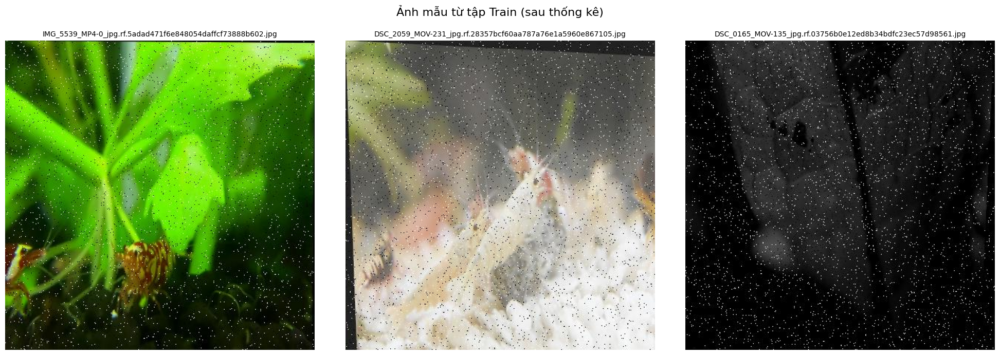

\nĐang xử lý thống kê cho tập Validation...
\nThống kê cho tập Validation:
  Đường dẫn ảnh: /kaggle/input/datatom/valid/images
  Đường dẫn nhãn: /kaggle/input/datatom/valid/labels
  Tổng số ảnh: 2222
  Số ảnh có nhãn: 2049
  Tổng số đối tượng (nhãn): 3619
  Phân bố đối tượng theo lớp:
    - Tôm đốm đen: 284
    - Tôm sét xanh: 249
    - Tôm pha lê đỏ đen: 700
    - Tôm hổ họa tiết đen: 174
    - Tôm vua khổng lồ đen: 70
    - Tôm đồng cổ truyền: 834
    - Tôm hổ mắt cam: 279
    - Tôm gấu trúc đen: 86
    - Tôm đốm đỏ: 243
    - Tôm hổ gấu mèo: 86
    - Tôm bóng mờ Mosura: 48
    - Tôm hổ cam: 43
    - Tôm vàng trắng: 523
\nHiển thị ảnh mẫu từ tập Validation (sau thống kê):


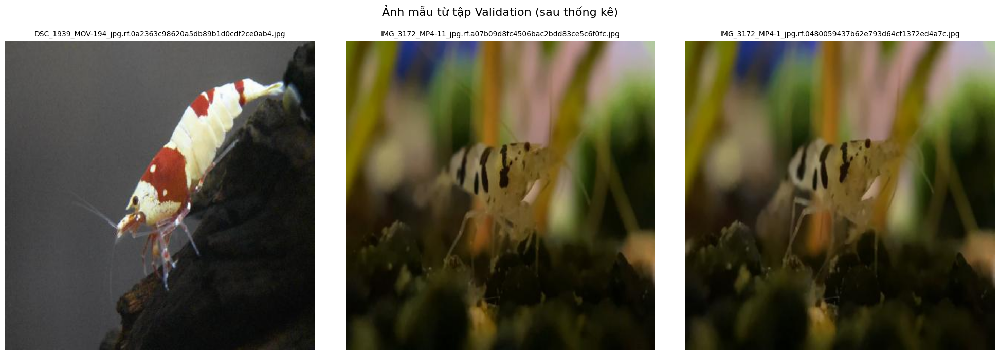

\nĐang xử lý thống kê cho tập Test...
\nThống kê cho tập Test:
  Đường dẫn ảnh: /kaggle/input/datatom/test/images
  Đường dẫn nhãn: /kaggle/input/datatom/test/labels
  Tổng số ảnh: 1166
  Số ảnh có nhãn: 1061
  Tổng số đối tượng (nhãn): 1854
  Phân bố đối tượng theo lớp:
    - Tôm đốm đen: 148
    - Tôm sét xanh: 135
    - Tôm pha lê đỏ đen: 357
    - Tôm hổ họa tiết đen: 101
    - Tôm vua khổng lồ đen: 36
    - Tôm đồng cổ truyền: 383
    - Tôm hổ mắt cam: 156
    - Tôm gấu trúc đen: 45
    - Tôm đốm đỏ: 123
    - Tôm hổ gấu mèo: 49
    - Tôm bóng mờ Mosura: 22
    - Tôm hổ cam: 29
    - Tôm vàng trắng: 270
\nHiển thị ảnh mẫu từ tập Test (sau thống kê):


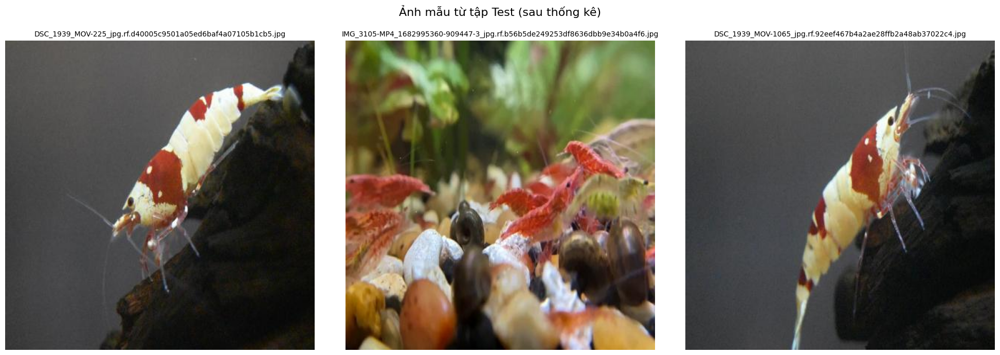

\n\n--- Thống kê Tổng cộng trên Toàn bộ Dữ liệu (Train + Validation + Test) ---
  Tổng số ảnh (toàn bộ): 26819
  Tổng số ảnh có nhãn (toàn bộ): 24652
  Tổng số đối tượng (nhãn) (toàn bộ): 42582
  Phân bố đối tượng theo lớp (toàn bộ):
    - Tôm đốm đen: 3368
    - Tôm sét xanh: 3128
    - Tôm pha lê đỏ đen: 8399
    - Tôm hổ họa tiết đen: 2262
    - Tôm vua khổng lồ đen: 823
    - Tôm đồng cổ truyền: 9635
    - Tôm hổ mắt cam: 3169
    - Tôm gấu trúc đen: 895
    - Tôm đốm đỏ: 2545
    - Tôm hổ gấu mèo: 1204
    - Tôm bóng mờ Mosura: 562
    - Tôm hổ cam: 490
    - Tôm vàng trắng: 6102


In [5]:
import os # Ensure os is imported if not already in this cell (it is imported in cell 7)
import traceback # Thêm import traceback để lấy thông tin chi tiết lỗi

# Removed intensive debugging flag and related prints for cleaner output

def get_dataset_statistics(image_dir, label_dir, class_names_list):
    # global first_contentful_file_debug_done # No longer needed
    if not os.path.exists(image_dir) or not os.path.exists(label_dir):
        print(f"Thư mục ảnh ({image_dir}) hoặc nhãn ({label_dir}) không tồn tại.")
        return None, None, None, None 
    
    image_files = [f for f in os.listdir(image_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
    num_images = len(image_files)
    
    if not class_names_list or not all(isinstance(name, str) for name in class_names_list):
        print(f"Lỗi: Danh sách tên lớp (class_names_list) không hợp lệ hoặc không phải là list các chuỗi trong get_dataset_statistics cho thư mục {image_dir}.")
        # ... (rest of the error handling for class_names_list) ...
        return num_images, 0, {}, 0

    class_counts = {str(cls_name): 0 for cls_name in class_names_list} 
    num_labels_total = 0
    images_with_labels = set()
    
    encodings_to_try = ['utf-8-sig', 'utf-8', 'latin-1', 'cp1252']
    # class_name_to_id = {name: i for i, name in enumerate(class_names_list)} # Not strictly needed if class_id is always int

    for img_file in image_files:
        label_file = os.path.splitext(img_file)[0] + '.txt'
        label_path = os.path.join(label_dir, label_file)
        
        if os.path.exists(label_path):
            # ... (encoding loop and file reading logic) ...
            for encoding in encodings_to_try:
                try:
                    with open(label_path, 'r', encoding=encoding) as f:
                        lines = f.readlines()
                    
                    file_had_content = bool(lines)
                    has_valid_label_in_this_file = False
                    
                    # perform_intensive_debug = False # Intensive debug is now disabled

                    for line_number, line_content in enumerate(lines, 1):
                        current_line_stripped = line_content.strip()
                        parts_original = current_line_stripped.split()
                        
                        # if perform_intensive_debug and line_number <= 5: # Debug logic removed
                        #     ...

                        if not parts_original: 
                            continue

                        if len(parts_original) < 5:
                            # print(f"Cảnh báo (File: {label_path}, Line: {line_number}): Dòng không đủ 5 phần tử. Dòng: '{current_line_stripped}'") # Optional: keep for less verbose warning
                            continue
                        
                        parts = parts_original[:5]
                        class_identifier_str = parts[0]
                        actual_class_id = -1
                        try:
                            parsed_id = int(class_identifier_str)
                            if 0 <= parsed_id < len(class_names_list):
                                actual_class_id = parsed_id
                        except ValueError:
                            try: # Attempt to parse as float then int, e.g. "5.0"
                                parsed_id = int(float(class_identifier_str))
                                if 0 <= parsed_id < len(class_names_list):
                                    actual_class_id = parsed_id
                            except ValueError:
                                # If class_names_list was a dict {name: id}, this would be useful.
                                # For now, assuming IDs are integers in the label files.
                                # print(f"Cảnh báo: Không thể phân tích class_id '{class_identifier_str}' thành số nguyên.")
                                pass
                        
                        if actual_class_id == -1:
                            # print(f"Cảnh báo (File: {label_path}, Line: {line_number}): class_id '{class_identifier_str}' không hợp lệ. Dòng: '{current_line_stripped}'") # Optional
                            continue
                        
                        try:
                            x_center, y_center, box_width, box_height = map(float, parts[1:])
                            if not (0 <= x_center <= 1 and 0 <= y_center <= 1 and 0 <= box_width <= 1 and 0 <= box_height <= 1):
                                # print(f"Cảnh báo (File: {label_path}, Line: {line_number}): Tọa độ không hợp lệ. Dòng: '{current_line_stripped}'") # Optional
                                continue
                        except ValueError:
                            # print(f"Cảnh báo (File: {label_path}, Line: {line_number}): Không thể phân tích tọa độ. Dòng: '{current_line_stripped}'") # Optional
                            continue
                        
                        class_name_key = class_names_list[actual_class_id]
                        class_counts[class_name_key] += 1
                        num_labels_total += 1
                        has_valid_label_in_this_file = True

                    if has_valid_label_in_this_file:
                        images_with_labels.add(img_file)
                    
                    # if perform_intensive_debug: # Debug logic removed
                    #    first_contentful_file_debug_done = True 
                    break 
                
                except UnicodeDecodeError:
                    if encoding == encodings_to_try[-1]:
                        print(f"Lỗi UnicodeDecodeError: Không thể giải mã tệp nhãn {label_path} bằng bất kỳ bảng mã nào đã thử.")
                except Exception as e:
                    print(f"--- LỖI NGOẠI LỆ CHUNG KHI XỬ LÝ TỆP NHÃN ---")
                    print(f"  Tệp: {label_path}, Mã hóa đang thử: {encoding}")
                    print(f"  Loại ngoại lệ: {type(e).__name__}, Lỗi: {e}")
                    traceback.print_exc()
                    break 
            
    num_images_with_labels = len(images_with_labels)
    return num_images, num_images_with_labels, class_counts, num_labels_total

# Assuming data_config, class_names, train_images_path, val_images_path, test_images_path 
# are defined and populated from a previous cell.
# Also assuming display_sample_images_with_labels is defined in a previous cell (cell 10).

if data_config and class_names:
    print("\\n--- Thống kê bộ dữ liệu ---")
    # first_contentful_file_debug_done = False # No longer needed
    
    path_definitions = [
        ("Train", train_images_path, 'train'), 
        ("Validation", val_images_path, 'valid'), 
        ("Test", test_images_path, 'test')
    ]
    
    # Calculate total statistics across all splits
    grand_total_images = 0
    grand_total_images_with_labels = 0
    grand_total_labels = 0
    grand_class_counts = {str(cls_name): 0 for cls_name in class_names}

    for split_name, current_image_path, label_path_key_part_unused in path_definitions:
        # first_contentful_file_debug_done = False # No longer needed for individual splits
            
        if current_image_path and os.path.exists(current_image_path):
            current_label_path = ""
            # ... (logic to determine current_label_path remains the same) ...
            base_name = os.path.basename(current_image_path.rstrip('/\\\\'))
            dir_name = os.path.dirname(current_image_path.rstrip('/\\\\'))

            if base_name == 'images':
                current_label_path = os.path.join(dir_name, 'labels')
            elif 'images' in base_name: 
                current_label_path = os.path.join(dir_name, base_name.replace('images', 'labels'))
            else: 
                if 'images' in current_image_path:
                    current_label_path = current_image_path.replace('images', 'labels', 1)
                else: 
                    current_label_path = os.path.join(os.path.dirname(current_image_path), 'labels') 
                    print(f"Cảnh báo: Không thể tự động suy ra đường dẫn thư mục nhãn từ '{current_image_path}' cho tập {split_name} một cách rõ ràng. Đang thử '{current_label_path}'.")

            if not os.path.exists(current_label_path):
                print(f"Thư mục nhãn cho {split_name} không tìm thấy tại {current_label_path}. Bỏ qua thống kê và hiển thị ảnh cho tập này.")
                continue
            
            print(f"\\nĐang xử lý thống kê cho tập {split_name}...") 
            num_img, num_img_with_lbl, cls_counts, num_lbl_total = get_dataset_statistics(current_image_path, current_label_path, class_names)
            
            if num_img is not None: 
                print(f"\\nThống kê cho tập {split_name}:")
                print(f"  Đường dẫn ảnh: {current_image_path}")
                print(f"  Đường dẫn nhãn: {current_label_path}")
                print(f"  Tổng số ảnh: {num_img}")
                print(f"  Số ảnh có nhãn: {num_img_with_lbl}")
                print(f"  Tổng số đối tượng (nhãn): {num_lbl_total}")
                print(f"  Phân bố đối tượng theo lớp:")
                if cls_counts and num_lbl_total > 0: 
                    for cls_name_stat, count_val in cls_counts.items(): # Renamed count to count_val to avoid conflict
                        print(f"    - {str(cls_name_stat)}: {count_val}") 
                elif num_lbl_total == 0 and num_img_with_lbl > 0 : 
                     print("    Không có đối tượng nào được tìm thấy với các lớp đã định nghĩa, hoặc các tệp nhãn không chứa ID lớp hợp lệ.")
                elif num_img_with_lbl == 0:
                    print("    Không có tệp nhãn nào được tìm thấy hoặc xử lý cho các ảnh trong tập này.")
                else: 
                    print("    Không có thông tin phân bố lớp hoặc không có nhãn nào được đếm.")

                # Add to grand totals
                grand_total_images += num_img
                grand_total_images_with_labels += num_img_with_lbl
                grand_total_labels += num_lbl_total
                if cls_counts:
                    for cls_name_stat, count_val in cls_counts.items():
                        grand_class_counts[cls_name_stat] = grand_class_counts.get(cls_name_stat, 0) + count_val

                # Display sample images for the current split
                print(f"\\nHiển thị ảnh mẫu từ tập {split_name} (sau thống kê):")
                # Assuming display_sample_images_with_labels is defined in cell 10 and available here
                display_sample_images_with_labels(current_image_path, current_label_path, 
                                                  title=f"Ảnh mẫu từ tập {split_name} (sau thống kê)", 
                                                  class_names_list=class_names, num_samples=3) # Display 3 samples
            else:
                print(f"Không thể lấy thống kê cho tập {split_name}.")
        else:
            # ... (handling for non-existent image path) ...
            if current_image_path: 
                 print(f"Đường dẫn ảnh cho tập {split_name} ({current_image_path}) không tồn tại hoặc không truy cập được.")
            else: 
                 print(f"Đường dẫn ảnh cho tập {split_name} không được cấu hình (giá trị là None). Bỏ qua thống kê.")
    
    # Print Grand Total Statistics
    print("\\n\\n--- Thống kê Tổng cộng trên Toàn bộ Dữ liệu (Train + Validation + Test) ---")
    print(f"  Tổng số ảnh (toàn bộ): {grand_total_images}")
    print(f"  Tổng số ảnh có nhãn (toàn bộ): {grand_total_images_with_labels}")
    print(f"  Tổng số đối tượng (nhãn) (toàn bộ): {grand_total_labels}")
    print(f"  Phân bố đối tượng theo lớp (toàn bộ):")
    if grand_total_labels > 0:
        for cls_name_stat, count_val in grand_class_counts.items():
            print(f"    - {str(cls_name_stat)}: {count_val}")
    else:
        print("    Không có đối tượng nào được đếm trên toàn bộ dữ liệu.")

else:
    # ... (handling for data_config or class_names not loaded) ...
    print("Không thể thực hiện thống kê do data_config hoặc class_names chưa được tải hoặc không hợp lệ.")
    if not data_config:
        print("  Lý do: Biến 'data_config' chưa được tải (có thể do lỗi ở cell đọc file data.yaml).")
    if not class_names: 
        print("  Lý do: Biến 'class_names' chưa được tải hoặc rỗng (kiểm tra 'nc' và 'names' trong data.yaml).")

Summarized conversation history

### 2.2. Mô hình YOLOv8 (YOLOv8 Model)

In [6]:
# Chọn mô hình, ví dụ yolov8n.pt (nhẹ hơn yolov8s.pt)
# Model này sẽ được YOLO tự động tải về nếu có internet.
# Nếu bạn muốn tải file .pt lên Kaggle dataset (ví dụ: /kaggle/input/datatom/yolov8n.pt), 
# hãy bỏ comment dòng dưới và cập nhật đường dẫn:
# model_variant = '/kaggle/input/datatom/yolov8n.pt' 
model_variant = 'yolov8n.pt' 
print(f"\nSử dụng mô hình YOLOv8: {model_variant}")

# Kiểm tra GPU
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f"Thiết bị sử dụng để huấn luyện: {device}")
if device == 'cuda':
    print(f"  Tên GPU: {torch.cuda.get_device_name(0)}")
    print(f"  Số lượng GPU khả dụng: {torch.cuda.device_count()}" )


Sử dụng mô hình YOLOv8: yolov8n.pt
Thiết bị sử dụng để huấn luyện: cuda
  Tên GPU: Tesla P100-PCIE-16GB
  Số lượng GPU khả dụng: 1


### 2.2.1. Cấu hình Model và Lựa chọn `yolov8n.pt` cho Kaggle

Lấy cảm hứng từ nhu cầu về một mô hình nhẹ và hiệu quả, chúng ta sẽ sử dụng `yolov8n.pt` (phiên bản "nano" của YOLOv8). Đây là phiên bản nhỏ nhất, giúp huấn luyện nhanh hơn và yêu cầu ít tài nguyên hơn so với `yolov8s.pt`, phù hợp cho các thử nghiệm ban đầu hoặc khi tốc độ là ưu tiên.

**Cách hoạt động trên Kaggle:**
*   **Tự động tải về (Mặc định):** Nếu notebook Kaggle của bạn có quyền truy cập internet, dòng code `model_variant = 'yolov8n.pt'` sẽ tự động tải mô hình này từ Ultralytics.
*   **Tải lên thủ công:** Nếu bạn muốn tải tệp `yolov8n.pt` lên cùng với bộ dữ liệu của mình trên Kaggle (ví dụ: vào thư mục `/kaggle/input/datatom/`), bạn cần:
    1.  Tải tệp `yolov8n.pt` lên Kaggle dataset của bạn.
    2.  Trong cell Python bên dưới, thay đổi `model_variant = 'yolov8n.pt'` thành `model_variant = '/kaggle/input/datatom/yolov8n.pt'` (bỏ comment và cập nhật dòng tương ứng).

Mô hình `yolov8s.pt` (small) được chọn cho thí nghiệm này. Đây là một phiên bản cân bằng tốt giữa tốc độ và độ chính xác, phù hợp cho việc huấn luyện trên các bộ dữ liệu tùy chỉnh với tài nguyên phần cứng vừa phải. 
Kiến trúc của YOLOv8 bao gồm ba phần chính:
- **Backbone:** Sử dụng kiến trúc CSPDarknet (tương tự YOLOv5 nhưng có cải tiến), chịu trách nhiệm trích xuất các đặc trưng từ ảnh đầu vào ở các tầng khác nhau.
- **Neck:** Sử dụng cấu trúc PAN (Path Aggregation Network) kết hợp các đặc trưng từ backbone ở các mức độ khác nhau để tăng cường thông tin ngữ nghĩa và vị trí.
- **Head:** Là phần đầu ra, thực hiện việc dự đoán bounding box, điểm tin cậy của đối tượng và xác suất lớp. YOLOv8 sử dụng một decoupled head (tách biệt đầu ra cho box và class), anchor-free, giúp đơn giản hóa quá trình khớp nhãn và cải thiện hiệu suất.

### 2.3. Quá trình Huấn luyện (Training Process)

Thiết lập các tham số huấn luyện:

In [7]:
results_training = None # Khởi tạo biến để lưu kết quả huấn luyện
experiment_save_dir = None # Khởi tạo biến lưu đường dẫn kết quả
project_name = 'YOLOv8_Shrimp_Detection' # Tên project lưu kết quả

if data_config and os.path.exists(data_yaml_path): # Chỉ chạy nếu data_config đã được tải thành công và file yaml tồn tại
    # Khởi tạo mô hình
    model = YOLO(model_variant) 

    # Các tham số huấn luyện
    epochs = 50 # Số lượng epochs, bạn có thể bắt đầu với số nhỏ hơn (3-5) để test
    batch_size = 16 # Kích thước batch, điều chỉnh tùy theo GPU (-1 để YOLO tự động chọn)
    img_size = 640 # Kích thước ảnh đầu vào
    optimizer = 'AdamW' # Hoặc 'SGD', 'Adam', YOLOv8 sẽ tự chọn mặc định tốt nếu không chỉ định
    learning_rate = 0.01 # Tốc độ học ban đầu (lr0)
    patience_epochs = 10 # Số epochs chờ nếu không có cải thiện trước khi dừng sớm (early stopping)
    # project_name đã định nghĩa ở trên
    experiment_name = f'{os.path.splitext(model_variant)[0]}_customData_e{epochs}_b{batch_size}_img{img_size}' # Tên của lần chạy cụ thể

    print(f"Bắt đầu quá trình huấn luyện với các tham số:")
    print(f"  Model: {model_variant}")
    print(f"  Data config: {data_yaml_path}")
    print(f"  Epochs: {epochs}")
    print(f"  Batch size: {batch_size}")
    print(f"  Image size: {img_size}")
    print(f"  Device: {device}")
    print(f"  Optimizer: {optimizer}")
    print(f"  Initial Learning Rate: {learning_rate}")
    print(f"  Patience for Early Stopping: {patience_epochs}")
    print(f"  Project: {project_name}")
    print(f"  Experiment Name: {experiment_name}")
    
    # Bỏ comment khối try-except dưới đây để bắt đầu huấn luyện
    print("LƯU Ý: BỎ COMMENT KHỐI TRY-EXCEPT DƯỚI ĐÂY ĐỂ CHẠY HUẤN LUYỆN THỰC SỰ.")
    try:
        results_training = model.train(
            data=data_yaml_path, 
            epochs=epochs, 
            imgsz=img_size, 
            batch=batch_size, 
            device=device, 
            optimizer=optimizer, 
            lr0=learning_rate,
            patience=patience_epochs,
            project=project_name,
            name=experiment_name,
            exist_ok=True # Cho phép ghi đè nếu experiment name đã tồn tại (hoặc tạo mới nếu chưa có)
        )        
        print("Hoàn thành huấn luyện!")
        if results_training and hasattr(results_training, 'save_dir'):
            experiment_save_dir = results_training.save_dir
            print(f"Kết quả được lưu tại: {experiment_save_dir}" )
        else:
            # Cố gắng tìm thư mục nếu results_training không có save_dir (ít khi xảy ra với train thành công)
            experiment_save_dir = os.path.join('runs', 'detect', project_name, experiment_name) # YOLOv8 thường lưu vào runs/detect/project/name
            if not os.path.exists(experiment_save_dir): # Sửa lại đường dẫn nếu là task detect
                 experiment_save_dir = os.path.join('runs', 'train', project_name, experiment_name) # YOLOv8 train thường lưu vào runs/train/project/name
            print(f"Thư mục kết quả (dự kiến): {experiment_save_dir}" )
            
    except Exception as e:
        print(f"LỖI trong quá trình huấn luyện: {e}" )
        results_training = None # Đặt results là None nếu có lỗi
else:
    print("Không thể bắt đầu huấn luyện do data_config chưa được tải hoặc data_yaml_path không tồn tại.")
    results_training = None

100%|██████████| 6.25M/6.25M [00:00<00:00, 233MB/s]

Bắt đầu quá trình huấn luyện với các tham số:
  Model: yolov8n.pt
  Data config: /kaggle/input/datayami/data.yaml
  Epochs: 50
  Batch size: 16
  Image size: 640
  Device: cuda
  Optimizer: AdamW
  Initial Learning Rate: 0.01
  Patience for Early Stopping: 10
  Project: YOLOv8_Shrimp_Detection
  Experiment Name: yolov8n_customData_e50_b16_img640
LƯU Ý: BỎ COMMENT KHỐI TRY-EXCEPT DƯỚI ĐÂY ĐỂ CHẠY HUẤN LUYỆN THỰC SỰ.
Ultralytics 8.3.137 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/kaggle/input/datayami/data.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction

100%|██████████| 22.2M/22.2M [00:00<00:00, 51.7MB/s]


Overriding model.yaml nc=80 with nc=13

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytic

100%|██████████| 5.35M/5.35M [00:00<00:00, 192MB/s]


AMP: checks passed ✅
train: Fast image access ✅ (ping: 1.0±0.1 ms, read: 3.9±1.4 MB/s, size: 50.0 KB)


train: Scanning /kaggle/input/datatom/train/labels... 23431 images, 4 backgrounds, 101 corrupt: 100%|██████████| 23431/23431 [01:54<00:00, 205.03it/s]

train: /kaggle/input/datatom/train/images/3C443D67-6B0F-46C4-ADFD-3918D821A804_JPG.rf.319dab9f74808cf83e15c8ed218c3f4d.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0674      1.0059]
train: /kaggle/input/datatom/train/images/3C443D67-6B0F-46C4-ADFD-3918D821A804_JPG.rf.e4c265cd81765251e742b29668b28433.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [      1.063      1.0238]
train: /kaggle/input/datatom/train/images/3C443D67-6B0F-46C4-ADFD-3918D821A804_JPG.rf.fb542ab5dd10eddf9b1867e85f9e73c6.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0744      1.0211]
train: /kaggle/input/datatom/train/images/50FE86E1-E960-4E6C-9424-CFF7D008C215_JPG.rf.04b5e110b2e68c02c96e876943fc7529.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0673      1.0673]
train: /kaggle/input/datatom/train/images/50FE86E1-E960-4E6C-9424-CFF7D008C215_JPG.rf.9d568126b6792291fd

WARNING ⚠️ train: Cache directory /kaggle/input/datatom/train is not writeable, cache not saved.
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.4±0.5 ms, read: 2.1±0.1 MB/s, size: 18.7 KB)


val: Scanning /kaggle/input/datatom/valid/labels... 2222 images, 0 backgrounds, 16 corrupt: 100%|██████████| 2222/2222 [00:10<00:00, 206.57it/s]


val: /kaggle/input/datatom/valid/images/73F81052-2B84-4B29-AF96-A0E871F95D82_jpg.rf.676cef3c1c8dc696d3280b6f759b7102.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [      1.077]
val: /kaggle/input/datatom/valid/images/DSC_1778_JPG.rf.6caf4a2fb12f0e071108172c2ffd72dd.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0143]
val: /kaggle/input/datatom/valid/images/IMG_3180-MP4_1683076991-6827748-14_jpg.rf.b1d621004995c3bf918edc68c0871b9b.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0118]
val: /kaggle/input/datatom/valid/images/IMG_3180_MP4-17_jpg.rf.2cd07d284c2a855afd644286108ea49b.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0379]
val: /kaggle/input/datatom/valid/images/IMG_3180_MP4-18_jpg.rf.b5e79dd663b18e66f1d5a0ffcdc9c80f.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0159]
val: /kaggle/input/dat

       1/50      2.15G      2.021       4.43      2.213         62        640:   0%|          | 6/1459 [00:01<06:11,  3.91it/s]

       1/50      2.16G      2.007      4.342      2.176         62        640:   1%|          | 12/1459 [00:03<05:04,  4.76it/s]
100%|██████████| 755k/755k [00:00<00:00, 90.4MB/s]
       1/50      2.21G      1.756      2.523      1.873         15        640: 100%|██████████| 1459/1459 [04:48<00:00,  5.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:14<00:00,  4.63it/s]


                   all       2206       4021      0.635      0.413      0.518      0.289

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      2.49G      1.609      1.999      1.742          4        640: 100%|██████████| 1459/1459 [04:36<00:00,  5.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.24it/s]


                   all       2206       4021      0.692      0.493      0.583      0.361

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      2.51G      1.514      1.779      1.654          3        640: 100%|██████████| 1459/1459 [04:34<00:00,  5.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.21it/s]


                   all       2206       4021      0.727       0.69      0.746      0.469

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      2.53G      1.422      1.565      1.574          6        640: 100%|██████████| 1459/1459 [04:33<00:00,  5.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.23it/s]

                   all       2206       4021       0.82      0.715      0.791       0.54



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      2.53G       1.36      1.434      1.523          8        640: 100%|██████████| 1459/1459 [04:33<00:00,  5.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.13it/s]


                   all       2206       4021      0.846      0.753      0.832      0.573

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      2.56G      1.316      1.353      1.487          6        640: 100%|██████████| 1459/1459 [04:33<00:00,  5.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.09it/s]


                   all       2206       4021      0.862       0.75      0.834      0.587

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      2.58G      1.289      1.284      1.459         10        640: 100%|██████████| 1459/1459 [04:34<00:00,  5.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.17it/s]


                   all       2206       4021      0.828       0.78      0.853      0.599

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      2.59G       1.25      1.213      1.433          8        640: 100%|██████████| 1459/1459 [04:34<00:00,  5.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.24it/s]


                   all       2206       4021      0.879      0.808      0.879      0.635

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50       2.6G      1.228      1.164      1.415          2        640: 100%|██████████| 1459/1459 [04:34<00:00,  5.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.07it/s]


                   all       2206       4021      0.864      0.838      0.889      0.651

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      2.63G       1.21      1.136      1.401          8        640: 100%|██████████| 1459/1459 [04:37<00:00,  5.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.09it/s]


                   all       2206       4021      0.905      0.817      0.889      0.649

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      2.64G      1.187      1.102      1.386          3        640: 100%|██████████| 1459/1459 [04:35<00:00,  5.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.21it/s]


                   all       2206       4021      0.902      0.832      0.902      0.667

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      2.66G      1.166      1.071      1.372          5        640: 100%|██████████| 1459/1459 [04:36<00:00,  5.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.20it/s]


                   all       2206       4021      0.887      0.855      0.916      0.681

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      2.67G      1.157      1.053       1.36          3        640: 100%|██████████| 1459/1459 [04:37<00:00,  5.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.12it/s]

                   all       2206       4021      0.922      0.843      0.915      0.688



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50       2.7G      1.142      1.033      1.355          6        640: 100%|██████████| 1459/1459 [04:36<00:00,  5.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.05it/s]


                   all       2206       4021      0.902      0.861      0.917       0.69

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      2.71G      1.135      1.015      1.344         14        640: 100%|██████████| 1459/1459 [04:37<00:00,  5.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.07it/s]

                   all       2206       4021      0.925      0.849      0.923      0.697



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      2.73G      1.111     0.9803      1.328          7        640: 100%|██████████| 1459/1459 [04:36<00:00,  5.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  4.96it/s]


                   all       2206       4021      0.903      0.874      0.926      0.707

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      2.74G      1.104     0.9621      1.323          8        640: 100%|██████████| 1459/1459 [04:37<00:00,  5.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.15it/s]


                   all       2206       4021      0.917      0.861      0.925      0.714

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      2.76G      1.087     0.9362      1.309         15        640: 100%|██████████| 1459/1459 [04:36<00:00,  5.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.21it/s]


                   all       2206       4021      0.923      0.865      0.928      0.716

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      2.78G      1.073      0.928        1.3          5        640: 100%|██████████| 1459/1459 [04:37<00:00,  5.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  4.96it/s]

                   all       2206       4021      0.938       0.84      0.928      0.717



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50       2.8G      1.065     0.9062      1.292          6        640: 100%|██████████| 1459/1459 [04:35<00:00,  5.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.00it/s]


                   all       2206       4021      0.912      0.881      0.928      0.722

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50       2.8G      1.062     0.9032      1.292          5        640: 100%|██████████| 1459/1459 [04:37<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.02it/s]

                   all       2206       4021      0.924      0.869      0.933      0.726



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      2.83G      1.055     0.8988       1.29          6        640: 100%|██████████| 1459/1459 [04:36<00:00,  5.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.04it/s]


                   all       2206       4021      0.887      0.894       0.93      0.726

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      2.85G      1.043      0.882       1.28          5        640: 100%|██████████| 1459/1459 [04:35<00:00,  5.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.08it/s]

                   all       2206       4021      0.925       0.88      0.931      0.726



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      2.87G      1.029     0.8654      1.272         10        640: 100%|██████████| 1459/1459 [04:36<00:00,  5.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.21it/s]

                   all       2206       4021      0.915      0.877      0.933      0.727



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      2.87G      1.024     0.8585       1.27          4        640: 100%|██████████| 1459/1459 [04:36<00:00,  5.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.11it/s]


                   all       2206       4021      0.927      0.879      0.933      0.727

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50       2.9G      1.017     0.8456      1.261          6        640: 100%|██████████| 1459/1459 [04:34<00:00,  5.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.29it/s]

                   all       2206       4021      0.928      0.886      0.935      0.734



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      2.92G       1.02     0.8427      1.263          5        640: 100%|██████████| 1459/1459 [04:33<00:00,  5.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:14<00:00,  4.91it/s]


                   all       2206       4021      0.927      0.884      0.932      0.733

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      2.93G      1.007     0.8276      1.254          7        640: 100%|██████████| 1459/1459 [04:35<00:00,  5.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.16it/s]


                   all       2206       4021      0.932      0.881      0.933      0.737

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      2.94G     0.9988     0.8211      1.251          7        640: 100%|██████████| 1459/1459 [04:34<00:00,  5.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.25it/s]


                   all       2206       4021      0.933      0.882      0.935       0.74

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      2.97G     0.9883     0.8051       1.24         11        640: 100%|██████████| 1459/1459 [04:35<00:00,  5.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.22it/s]


                   all       2206       4021      0.933       0.88      0.935      0.741

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      2.98G     0.9849      0.799      1.242          7        640: 100%|██████████| 1459/1459 [04:34<00:00,  5.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.05it/s]

                   all       2206       4021      0.937       0.88      0.936      0.744



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50         3G     0.9771     0.7909      1.236          7        640: 100%|██████████| 1459/1459 [04:36<00:00,  5.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.06it/s]


                   all       2206       4021      0.934      0.886      0.937      0.746

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      3.01G     0.9749     0.7881      1.232          8        640: 100%|██████████| 1459/1459 [04:38<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.18it/s]


                   all       2206       4021      0.926      0.886      0.939      0.748

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      3.04G     0.9634     0.7737      1.225          6        640: 100%|██████████| 1459/1459 [04:38<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.21it/s]


                   all       2206       4021      0.925      0.887       0.94      0.749

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      3.05G     0.9545     0.7638       1.22         12        640: 100%|██████████| 1459/1459 [04:37<00:00,  5.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.19it/s]


                   all       2206       4021      0.925      0.888       0.94      0.749

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      3.07G     0.9516     0.7586       1.22         10        640: 100%|██████████| 1459/1459 [04:38<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.14it/s]


                   all       2206       4021      0.928      0.891      0.941       0.75

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      3.08G     0.9502     0.7553      1.219          2        640: 100%|██████████| 1459/1459 [04:38<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:14<00:00,  4.79it/s]

                   all       2206       4021      0.933      0.891      0.941       0.75



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50       3.1G     0.9385     0.7449       1.21          8        640: 100%|██████████| 1459/1459 [04:38<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:14<00:00,  4.86it/s]


                   all       2206       4021      0.934       0.89      0.941      0.752

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      3.12G     0.9352     0.7386      1.209         11        640: 100%|██████████| 1459/1459 [04:39<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.06it/s]


                   all       2206       4021      0.937      0.887      0.941      0.753

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      3.14G     0.9329     0.7305      1.207          3        640: 100%|██████████| 1459/1459 [04:39<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.11it/s]


                   all       2206       4021      0.941       0.89      0.941      0.755
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      3.15G     0.7744     0.4941      1.173          2        640: 100%|██████████| 1459/1459 [04:31<00:00,  5.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.07it/s]


                   all       2206       4021      0.938      0.891      0.941      0.755

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      3.17G     0.7565     0.4782      1.161          2        640: 100%|██████████| 1459/1459 [04:30<00:00,  5.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.15it/s]


                   all       2206       4021      0.938      0.893      0.941      0.756

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      3.19G     0.7444     0.4666      1.153          2        640: 100%|██████████| 1459/1459 [04:30<00:00,  5.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.14it/s]


                   all       2206       4021      0.934      0.895      0.941      0.758

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      3.21G     0.7337     0.4582      1.147          3        640: 100%|██████████| 1459/1459 [04:29<00:00,  5.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.14it/s]


                   all       2206       4021      0.931      0.898      0.941      0.759

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      3.21G      0.726     0.4504      1.142          5        640: 100%|██████████| 1459/1459 [04:29<00:00,  5.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.07it/s]

                   all       2206       4021      0.928      0.899      0.941       0.76



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      3.24G     0.7139     0.4416      1.132          3        640: 100%|██████████| 1459/1459 [04:30<00:00,  5.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.21it/s]

                   all       2206       4021      0.931      0.898      0.941      0.761



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      3.26G     0.7103     0.4366      1.132          3        640: 100%|██████████| 1459/1459 [04:30<00:00,  5.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:13<00:00,  5.16it/s]


                   all       2206       4021      0.928      0.897      0.941      0.762

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      3.28G     0.6992     0.4317      1.123          7        640: 100%|██████████| 1459/1459 [04:29<00:00,  5.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:14<00:00,  4.82it/s]


                   all       2206       4021      0.928      0.896      0.941      0.762

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      3.28G     0.6961     0.4269       1.12          4        640: 100%|██████████| 1459/1459 [04:29<00:00,  5.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:14<00:00,  4.61it/s]


                   all       2206       4021      0.927      0.896      0.941      0.763

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      3.31G     0.6889      0.423      1.116          3        640: 100%|██████████| 1459/1459 [04:29<00:00,  5.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:14<00:00,  4.92it/s]

                   all       2206       4021      0.928      0.896      0.941      0.763



50 epochs completed in 4.017 hours.
Optimizer stripped from YOLOv8_Shrimp_Detection/yolov8n_customData_e50_b16_img640/weights/last.pt, 6.3MB
Optimizer stripped from YOLOv8_Shrimp_Detection/yolov8n_customData_e50_b16_img640/weights/best.pt, 6.3MB

Validating YOLOv8_Shrimp_Detection/yolov8n_customData_e50_b16_img640/weights/best.pt...
Ultralytics 8.3.137 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 72 layers, 3,008,183 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 69/69 [00:15<00:00,  4.40it/s]


                   all       2206       4021      0.928      0.896      0.941      0.763
           Tôm đốm đen        314        315      0.986       0.92      0.988      0.874
          Tôm sét xanh        238        249      0.935      0.896      0.968      0.801
     Tôm pha lê đỏ đen        763        820      0.981      0.968      0.987      0.901
   Tôm hổ họa tiết đen        176        176      0.944      0.972      0.978      0.763
  Tôm vua khổng lồ đen         70         74       0.88      0.791      0.889      0.732
    Tôm đồng cổ truyền        334        920      0.841      0.855      0.891      0.638
        Tôm hổ mắt cam        335        352       0.94      0.935       0.96      0.782
      Tôm gấu trúc đen         91         92      0.939      0.859      0.905      0.727
            Tôm đốm đỏ        279        293      0.933      0.903      0.959      0.768
        Tôm hổ gấu mèo        107        107      0.878      0.878      0.932      0.653
    Tôm bóng mờ Mosur

### 2.4. Các chỉ số đánh giá (Assessment Indicators)
Hiệu suất của mô hình sẽ được đánh giá bằng các chỉ số tiêu chuẩn trong bài toán phát hiện đối tượng:
- **Precision (P):** Tỷ lệ giữa số lượng phát hiện đúng (True Positives - TP) trên tổng số lượng phát hiện (TP + False Positives - FP). $P = TP / (TP + FP)$. Cho biết độ chính xác của các phát hiện.
- **Recall (R):** Tỷ lệ giữa số lượng phát hiện đúng (TP) trên tổng số lượng đối tượng thực tế có trong dữ liệu (TP + False Negatives - FN). $R = TP / (TP + FN)$. Cho biết khả năng mô hình tìm thấy tất cả các đối tượng.
- **mAP@0.5 (mean Average Precision at IoU threshold 0.5):** Giá trị trung bình của Average Precision (AP) cho tất cả các lớp, với ngưỡng Intersection over Union (IoU) là 0.5. AP là diện tích dưới đường cong Precision-Recall.
- **mAP@0.5:0.95 (mean Average Precision averaged over IoU thresholds from 0.5 to 0.95):** Giá trị mAP được tính trung bình qua nhiều ngưỡng IoU khác nhau (từ 0.5 đến 0.95, bước nhảy 0.05). Đây là chỉ số chính được sử dụng trong nhiều cuộc thi phát hiện đối tượng (ví dụ COCO dataset).
Ngoài ra, các thông tin về **loss** trong quá trình huấn luyện (training loss, validation loss) cũng sẽ được theo dõi để đánh giá sự hội tụ của mô hình.

## 3. Kết quả và Thảo luận (Results and Discussion)

### 3.1. Kết quả Huấn luyện (Training Results)

Sau khi huấn luyện, các biểu đồ và kết quả sẽ được lưu trong thư mục được chỉ định (thường là `runs/train/PROJECT_NAME/EXPERIMENT_NAME/`). Chúng ta sẽ hiển thị chúng ở đây.

Hiển thị kết quả từ: YOLOv8_Shrimp_Detection/yolov8n_customData_e50_b16_img640

Biểu đồ tổng hợp các metrics (P, R, mAP, Loss):


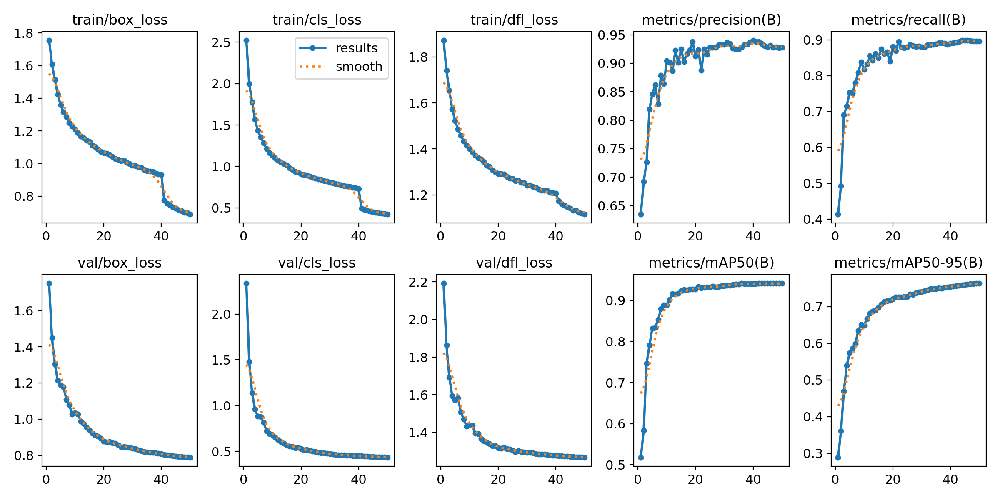


Ma trận nhầm lẫn (Confusion Matrix):


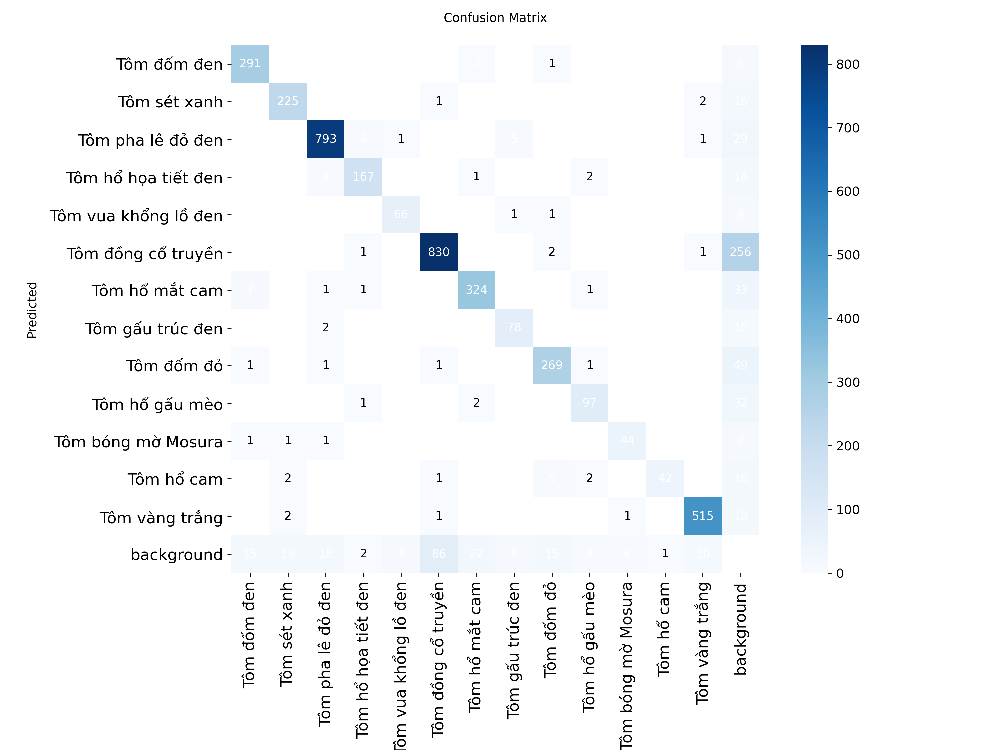


Ma trận nhầm lẫn Chuẩn hóa (Normalized Confusion Matrix):


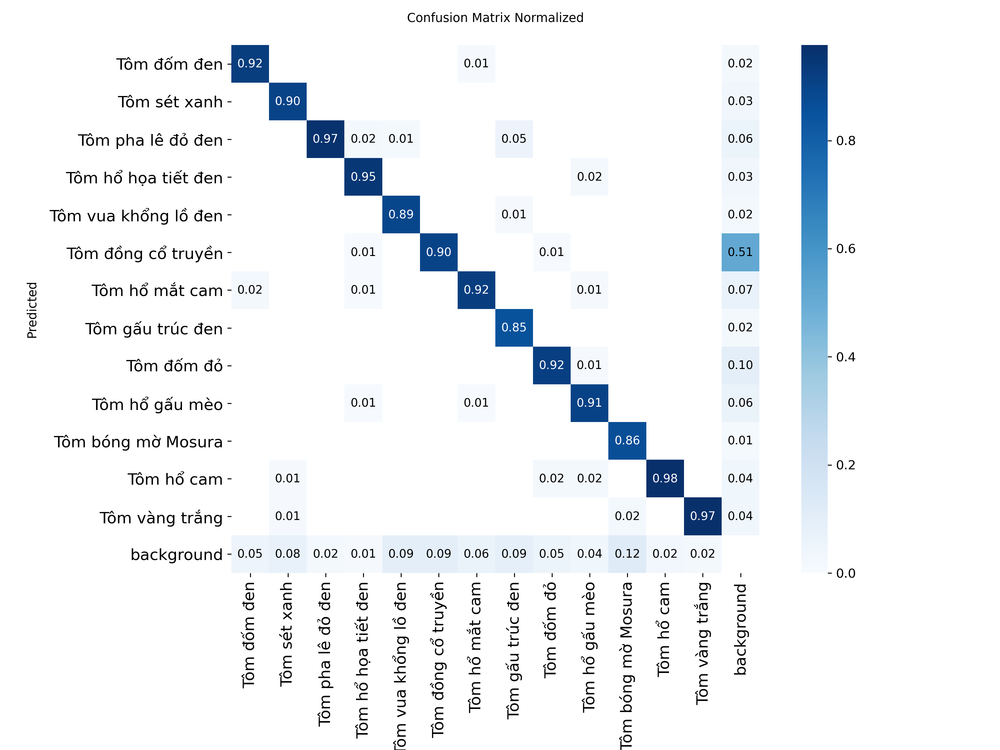


Các biểu đồ chi tiết khác (nếu có):

Biểu đồ P_curve.png:


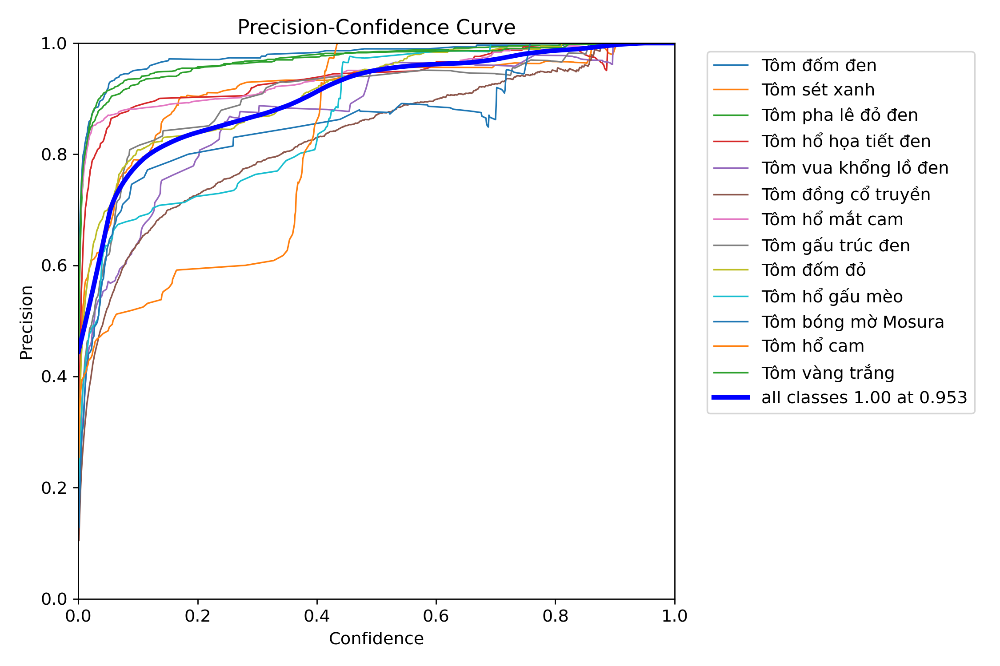


Biểu đồ R_curve.png:


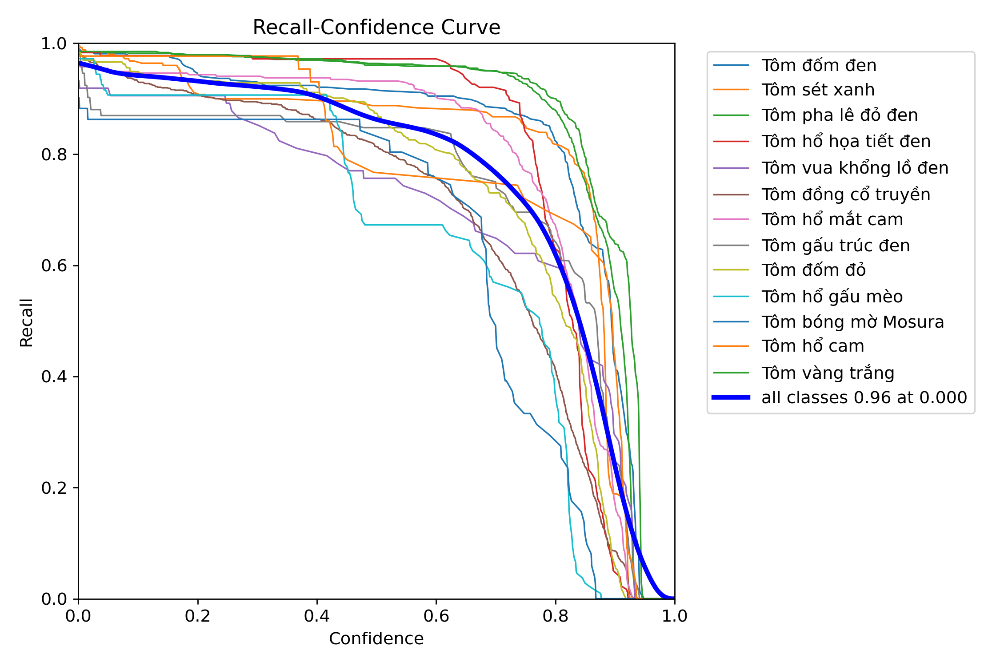


Biểu đồ F1_curve.png:


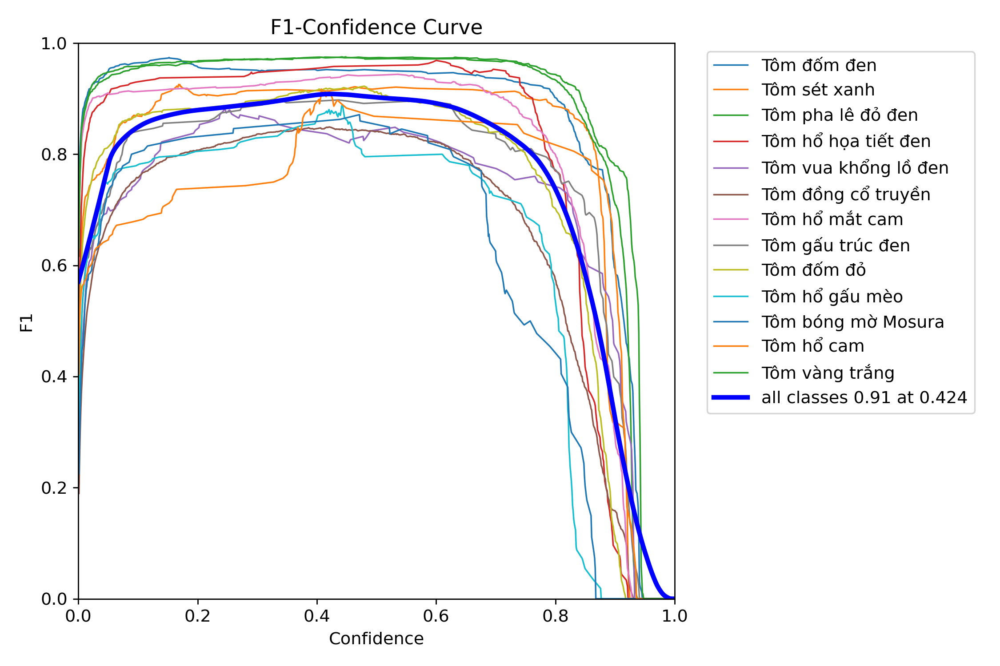


Biểu đồ PR_curve.png:


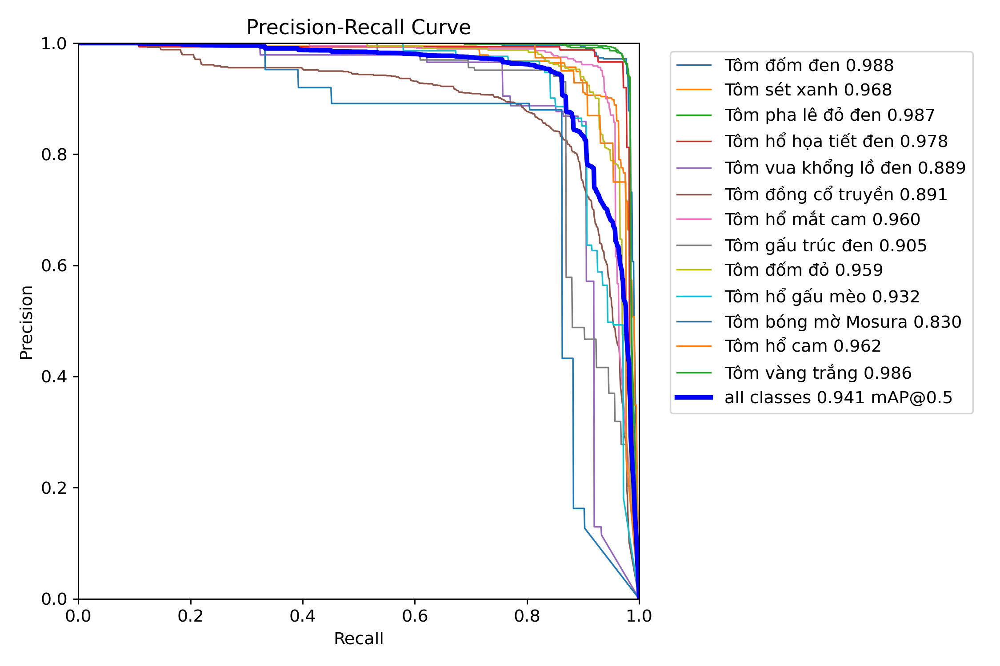


Biểu đồ labels.jpg:


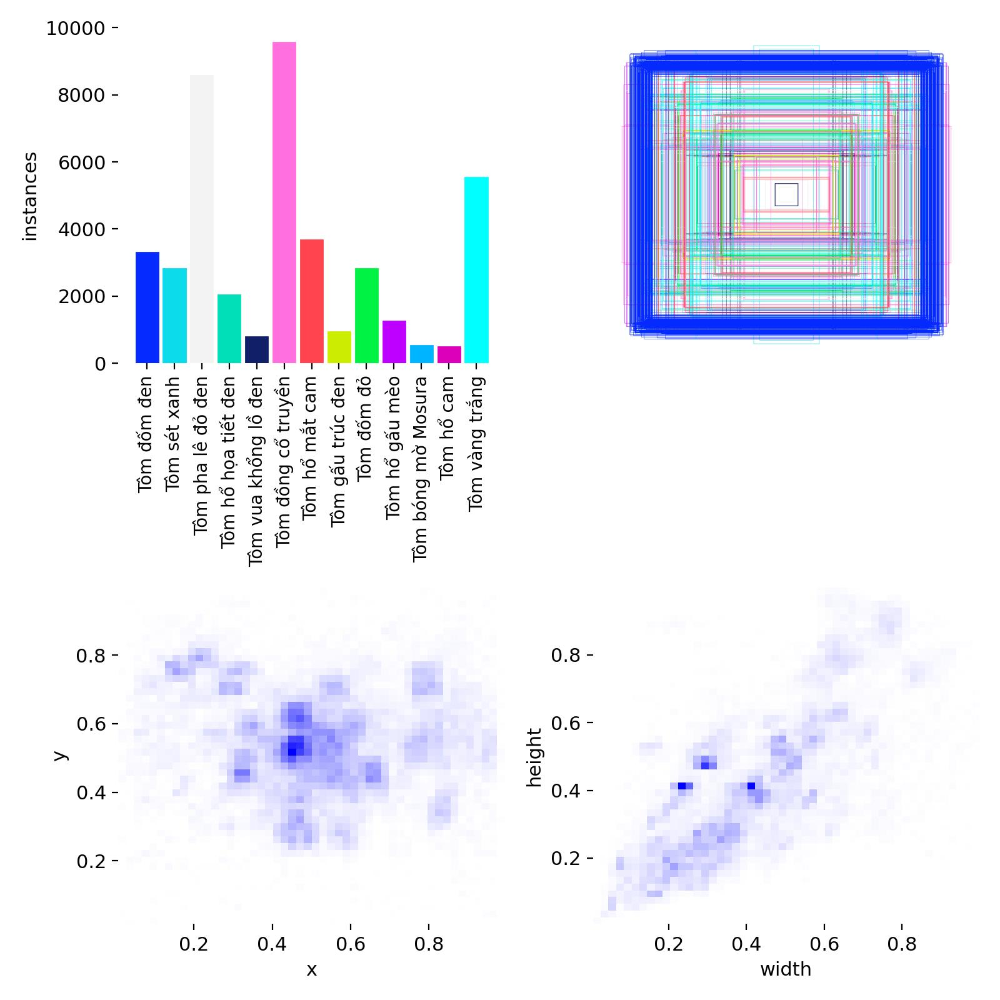


Biểu đồ labels_correlogram.jpg:


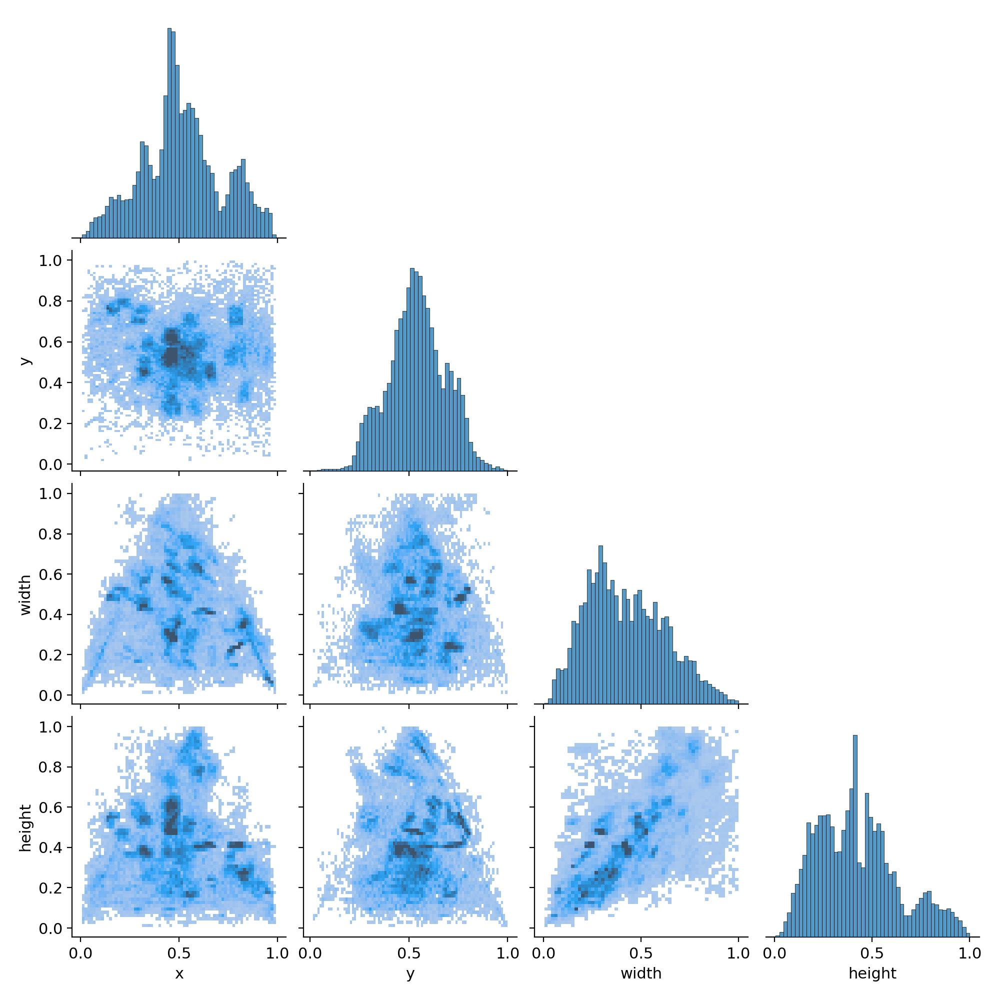


Biểu đồ val_batch0_labels.jpg:


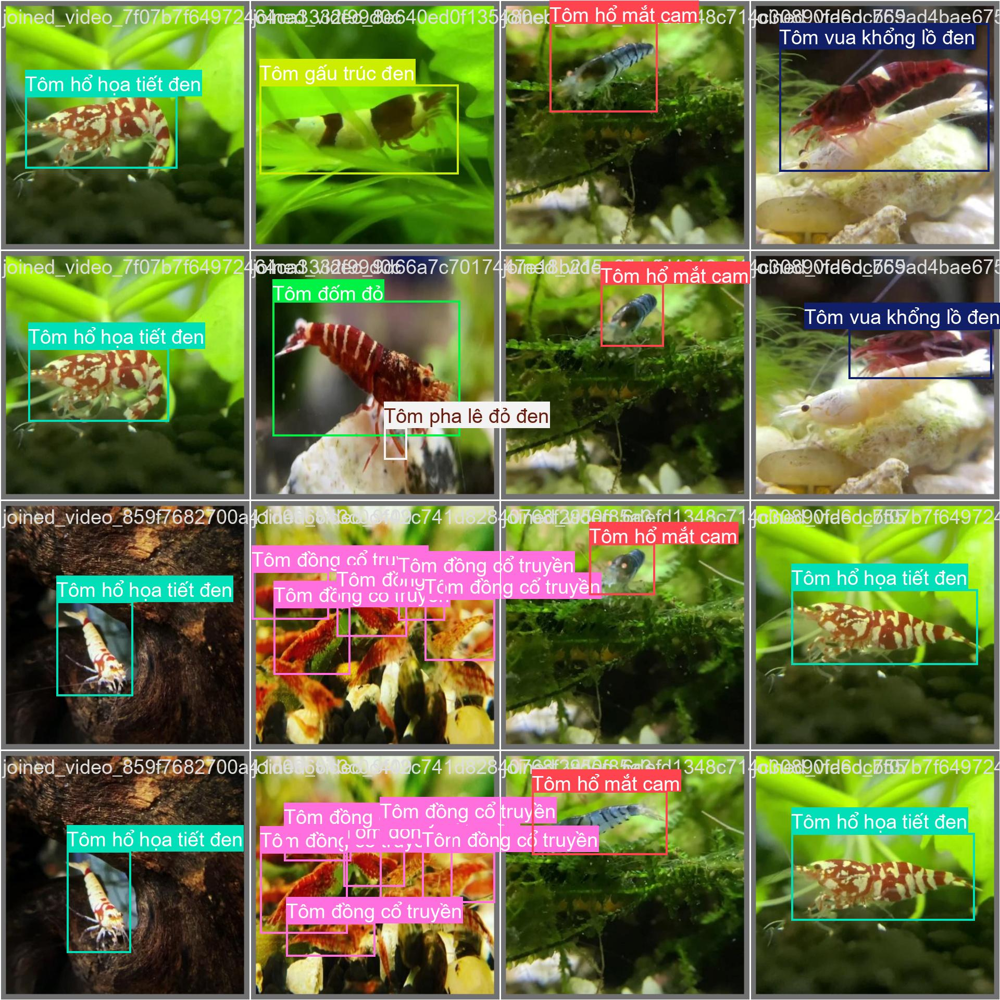


Biểu đồ val_batch0_pred.jpg:


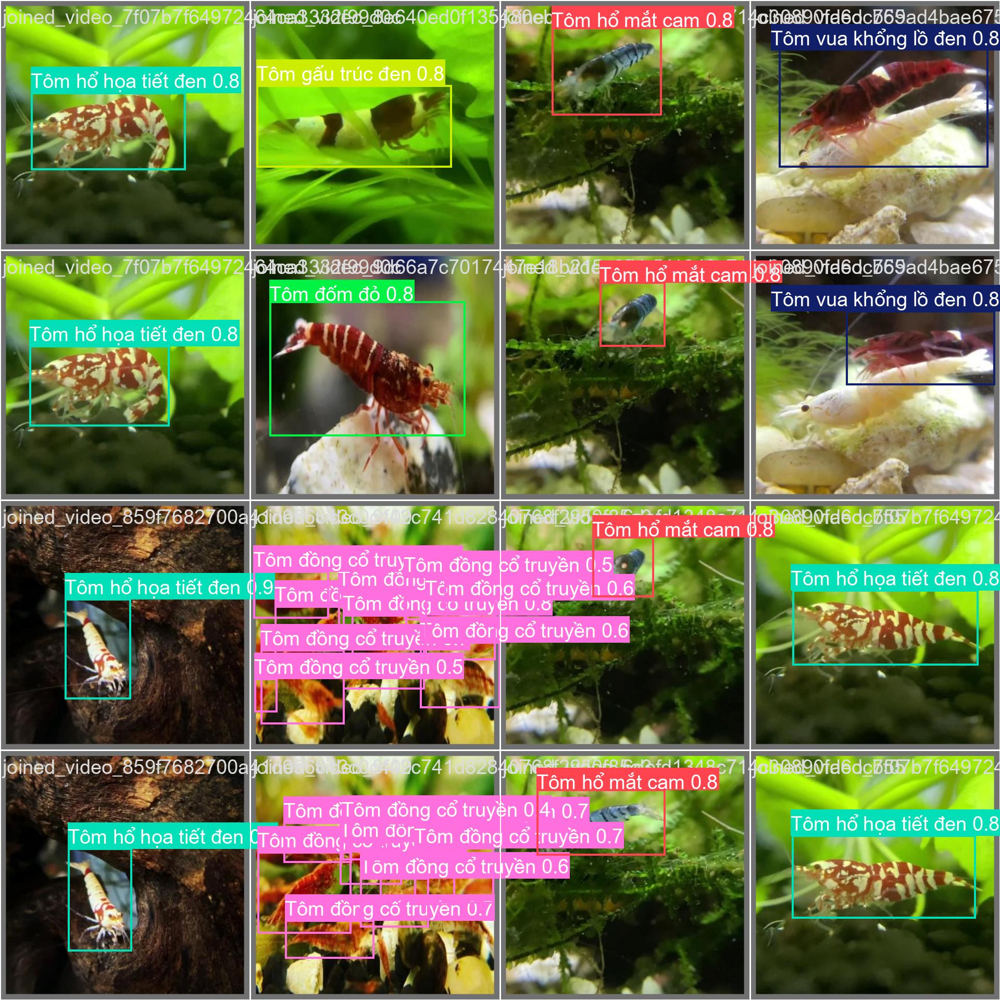


Bảng kết quả chi tiết (từ results.csv):


,epoch,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),train/box_loss,train/cls_loss,train/dfl_loss,val/box_loss,val/cls_loss,val/dfl_loss
45,46,0.93142,0.89799,0.94136,0.76117,0.71388,0.44164,1.13156,0.79364,0.43830,1.26982
46,47,0.92789,0.89712,0.94136,0.76189,0.71028,0.43664,1.13222,0.79237,0.43696,1.26894
47,48,0.92829,0.89594,0.94126,0.76248,0.69917,0.43169,1.12342,0.79113,0.43559,1.26836
48,49,0.92718,0.89633,0.94117,0.76302,0.69612,0.42688,1.12026,0.78986,0.43447,1.26759
49,50,0.92771,0.89578,0.94130,0.76345,0.68889,0.42295,1.11555,0.78876,0.43354,1.26698


In [8]:
# Cập nhật experiment_save_dir nếu nó chưa được đặt từ cell huấn luyện (ví dụ khi chạy lại notebook mà không huấn luyện lại)
if not experiment_save_dir: 
    # Cần đảm bảo project_name và experiment_name khớp với lần chạy bạn muốn xem kết quả
    # Ví dụ: experiment_name được định nghĩa trong cell huấn luyện
    temp_model_variant = 'yolov8n.pt' # <<< ĐÃ THAY ĐỔI TỪ yolov8s.pt SANG yolov8n.pt
    temp_epochs = 50
    temp_batch_size = 16
    temp_img_size = 640
    # Cần phải có project_name đã định nghĩa ở cell huấn luyện
    # project_name = 'YOLOv8_Shrimp_Detection' 
    temp_experiment_name = f'{os.path.splitext(temp_model_variant)[0]}_customData_e{temp_epochs}_b{temp_batch_size}_img{temp_img_size}'
    potential_path = os.path.join('runs', 'train', project_name, temp_experiment_name) # Sửa lại nếu task là 'detect'
    if os.path.exists(potential_path):
        experiment_save_dir = potential_path
    else: # Thử tìm thư mục mới nhất nếu tên cụ thể không có
        base_runs_dir = os.path.join('runs', 'train', project_name) # Sửa lại nếu task là 'detect'
        if os.path.exists(base_runs_dir):
            all_exps = [os.path.join(base_runs_dir, d) for d in os.listdir(base_runs_dir) if os.path.isdir(os.path.join(base_runs_dir, d))]
            if all_exps:        
                latest_exp_dir = max(all_exps, key=os.path.getmtime)
                experiment_save_dir = latest_exp_dir
                print(f"Không tìm thấy thư mục thí nghiệm cụ thể, sử dụng thư mục gần nhất: {experiment_save_dir}")

if experiment_save_dir and os.path.exists(experiment_save_dir):
    print(f"Hiển thị kết quả từ: {experiment_save_dir}")
    
    # Biểu đồ tổng hợp các metrics
    results_png_path = os.path.join(experiment_save_dir, 'results.png')
    if os.path.exists(results_png_path):
        print("\nBiểu đồ tổng hợp các metrics (P, R, mAP, Loss):")
        display(Image.open(results_png_path))
    else:
        print(f"Không tìm thấy results.png tại {results_png_path}" )
        
    # Ma trận nhầm lẫn
    confusion_matrix_path = os.path.join(experiment_save_dir, 'confusion_matrix.png')
    if os.path.exists(confusion_matrix_path):
        print("\nMa trận nhầm lẫn (Confusion Matrix):")
        display(Image.open(confusion_matrix_path))
    else:
        print(f"Không tìm thấy confusion_matrix.png tại {confusion_matrix_path}" )
    
    # Ma trận nhầm lẫn chuẩn hóa (nếu có)
    confusion_matrix_normalized_path = os.path.join(experiment_save_dir, 'confusion_matrix_normalized.png')
    if os.path.exists(confusion_matrix_normalized_path):
        print("\nMa trận nhầm lẫn Chuẩn hóa (Normalized Confusion Matrix):")
        display(Image.open(confusion_matrix_normalized_path))
    # else: # Không cần in nếu không có, vì nó không phải lúc nào cũng được tạo
        # print(f"Không tìm thấy confusion_matrix_normalized.png tại {confusion_matrix_normalized_path}" )
        
    # Hiển thị các biểu đồ khác nếu có
    print("\nCác biểu đồ chi tiết khác (nếu có):")
    other_plots = ['P_curve.png', 'R_curve.png', 'F1_curve.png', 'PR_curve.png', 
                   'labels.jpg', 'labels_correlogram.jpg', # Biểu đồ phân bố nhãn
                   'val_batch0_labels.jpg', 'val_batch0_pred.jpg' # Batch validation đầu tiên
                  ]
    for plot_name in other_plots:
        plot_path = os.path.join(experiment_save_dir, plot_name)
        if os.path.exists(plot_path):
            print(f"\nBiểu đồ {plot_name}:")
            display(Image.open(plot_path))
            
    # Bảng kết quả (từ file results.csv)
    results_csv_path = os.path.join(experiment_save_dir, 'results.csv')
    if os.path.exists(results_csv_path):
        import pandas as pd
        print("\nBảng kết quả chi tiết (từ results.csv):")
        df_results = pd.read_csv(results_csv_path)
        df_results.columns = df_results.columns.str.strip() # Làm sạch tên cột
        
        # Hiển thị một số cột quan trọng và 5 dòng cuối (thể hiện kết quả tốt nhất hoặc gần cuối)
        cols_to_display = ['epoch', 
                           'metrics/precision(B)', 'metrics/recall(B)', 
                           'metrics/mAP50(B)', 'metrics/mAP50-95(B)', 
                           'train/box_loss', 'train/cls_loss', 'train/dfl_loss', 
                           'val/box_loss', 'val/cls_loss', 'val/dfl_loss']
        # Lọc ra các cột thực sự tồn tại trong df_results
        existing_cols_to_display = [col for col in cols_to_display if col in df_results.columns]
        if existing_cols_to_display:
            display(df_results[existing_cols_to_display].tail())
        else:
            print("Không tìm thấy các cột metrics mong đợi trong results.csv. Hiển thị toàn bộ DataFrame:")
            display(df_results.tail())
    else:
        print(f"Không tìm thấy results.csv tại {results_csv_path}" )
else:
    print("Không tìm thấy thư mục lưu kết quả huấn luyện. Hãy đảm bảo quá trình huấn luyện đã chạy và `experiment_save_dir` được đặt đúng, hoặc bỏ comment phần code huấn luyện và chạy lại.")

### Important Notes for Result Visualization Cells (Cells 19, 20, 21 and beyond):

Before running the cells that display training results, evaluation metrics, or prediction visualizations, please ensure the following:

1.  **Python Libraries Imported**: Make sure the following Python libraries have been imported in earlier cells (typically in one of the first Python cells, e.g., Cell 7 or a dedicated setup cell):
    ```python
    from ultralytics import YOLO
    import torch
    import os
    import glob
    import pandas as pd
    from IPython.display import Image, display, Markdown # display is crucial for images in notebook
    import matplotlib.pyplot as plt # For plotting
    import numpy as np # For array operations, often used with plotting or image data
    import random
    import yaml
    import shutil # Useful for managing directories, e.g., cleaning up prediction folders
    ```

2.  **Key Variables Defined**: Ensure the following variables are defined and populated correctly, usually from the data loading (Cell 10) and training (Cell 16) steps:
    *   `data_yaml_path`: Absolute path to your `data.yaml` file (e.g., `'/kaggle/input/datatom/data.yaml'`). This is used by evaluation and prediction cells.
    *   `project_name`: The project name string used during training (e.g., `'YOLOv8_Shrimp_Detection'`). Used to locate results.
    *   `experiment_name`: The specific experiment name string (e.g., `'yolov8n_customData_e50_b16_img640'`). This is the subfolder where results for a particular run are stored.
    *   `experiment_save_dir`: The full, absolute path to the directory where training results for the *specific experiment* are saved. This is typically `os.path.join('runs', 'train', project_name, experiment_name)` or directly from `results_training.save_dir` after training. Cell 19 attempts to find this, but it's best if it's explicitly passed or correctly derived.
    *   `model_variant`: The model variant string, e.g., `'yolov8n.pt'`. Used by Cell 19 if `experiment_save_dir` is not found.
    *   `img_size`: Image size used for training (e.g., `640`). Used for evaluation and prediction consistency.
    *   `batch_size`: Batch size used for training (e.g., `16`). Can be used for evaluation.
    *   `device`: The device used for training (e.g., `'cuda'` or `'cpu'`). Used for evaluation.
    *   `class_names`: List of class names, loaded from `data.yaml`. Used for labeling visualizations.
    *   `val_images_path`, `test_images_path`: Paths to validation and test image directories, for visualization of predictions.

3.  **Training Completed**: The training process (Cell 16) must have been run successfully at least once for the `experiment_save_dir` to be created and populated with results like `results.png`, `results.csv`, `weights/best.pt`, etc.

4.  **Paths for Kaggle**: If running on Kaggle, ensure all paths are correctly set for the Kaggle environment (e.g., `/kaggle/input/...` for datasets, `/kaggle/working/...` for outputs if not automatically handled by YOLO in `runs/...`).

The subsequent cells (19, 20, 21) will attempt to use these variables to load and display the relevant information. If `experiment_save_dir` is not correctly set or found, those cells might not be able to locate the training outputs.

### 3.2. Đánh giá trên tập Kiểm thử (Evaluation on Test Set)

Nếu có tập test riêng biệt được định nghĩa trong `data.yaml` và thư mục test tồn tại, chúng ta sẽ đánh giá mô hình tốt nhất (`best.pt`) trên tập này.


Đánh giá mô hình tốt nhất (YOLOv8_Shrimp_Detection/yolov8n_customData_e50_b16_img640/weights/best.pt) trên tập test...
Ultralytics 8.3.137 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 72 layers, 3,008,183 parameters, 0 gradients, 8.1 GFLOPs
val: Fast image access ✅ (ping: 1.7±1.5 ms, read: 2.4±0.3 MB/s, size: 14.9 KB)


val: Scanning /kaggle/input/datatom/test/labels... 1166 images, 0 backgrounds, 5 corrupt: 100%|██████████| 1166/1166 [00:04<00:00, 234.40it/s]

val: /kaggle/input/datatom/test/images/58D7DA69-129F-44CE-AEC3-D18F7788F0AB_jpg.rf.25b4e925e0bf15e799e53eafd55a7df0.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [      1.075]
val: /kaggle/input/datatom/test/images/IMG_3180_MP4-24_jpg.rf.6d870ebf47b2426037c7ef6eec1a9a25.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0225]
val: /kaggle/input/datatom/test/images/IMG_3976_MOV-2_jpg.rf.c18576d1b8bf42b0294983a4d95ce5d9.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0061]
val: /kaggle/input/datatom/test/images/IMG_4111_MP4-5_jpg.rf.52488978a3eef15ff1e75e64ca7dce8d.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0017]
val: /kaggle/input/datatom/test/images/joined_video_72621e1ab9254b0b9d410bf02f9da18b-MP4_1683077614-1134205-0_jpg.rf.181ebdb90f74eb0559ed9864822ead5d.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates 

WARNING ⚠️ val: Cache directory /kaggle/input/datatom/test is not writeable, cache not saved.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 73/73 [00:08<00:00,  8.32it/s]


                   all       1161       2086      0.938      0.891      0.944      0.779
           Tôm đốm đen        170        170      0.984      0.935      0.992      0.874
          Tôm sét xanh        127        136      0.934      0.875      0.962      0.821
     Tôm pha lê đỏ đen        386        421      0.985      0.962       0.98      0.887
   Tôm hổ họa tiết đen        104        105      0.961      0.948      0.955      0.784
  Tôm vua khổng lồ đen         38         38      0.874      0.921      0.966      0.841
    Tôm đồng cổ truyền        158        435      0.857      0.834      0.883      0.635
        Tôm hổ mắt cam        180        188      0.954      0.936      0.968      0.798
      Tôm gấu trúc đen         51         53      0.916      0.823      0.905      0.689
            Tôm đốm đỏ        142        149      0.911      0.891      0.921      0.714
        Tôm hổ gấu mèo         57         57      0.956      0.767      0.921      0.653
    Tôm bóng mờ Mosur

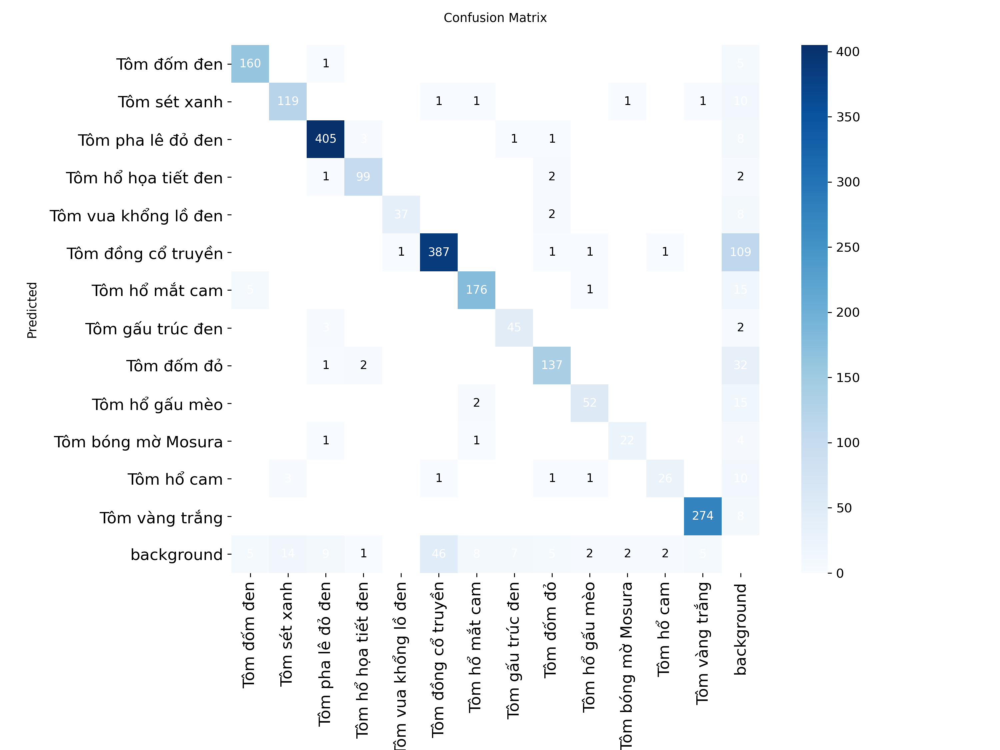


Biểu đồ mAP@0.5 theo từng lớp (Test Set):
LỖI trong quá trình đánh giá trên tập test: 'numpy.ndarray' object has no attribute 'cpu'


Traceback (most recent call last):
  File "/tmp/ipykernel_19/673941136.py", line 54, in <cell line: 0>
    per_class_map50_values = results_test.box.maps.cpu().numpy()
                             ^^^^^^^^^^^^^^^^^^^^^^^^^
AttributeError: 'numpy.ndarray' object has no attribute 'cpu'


In [9]:
results_test = None
if experiment_save_dir and os.path.exists(experiment_save_dir) and \
   data_config and test_images_path and os.path.exists(test_images_path) and \
   os.path.exists(test_images_path.replace('images','labels',1)): # Kiểm tra cả thư mục labels của test
    
    best_model_path = os.path.join(experiment_save_dir, 'weights', 'best.pt')
    if os.path.exists(best_model_path):
        print(f"\nĐánh giá mô hình tốt nhất ({best_model_path}) trên tập test...")
        model_best = YOLO(best_model_path)
        
        try:
            # Sử dụng split='test' để chỉ định đánh giá trên tập test đã định nghĩa trong data.yaml
            # Tên của lần chạy đánh giá này
            test_experiment_name = f'{os.path.splitext(os.path.basename(best_model_path))[0]}_test_evaluation'
            
            results_test = model_best.val(
                data=data_yaml_path, 
                split='test', 
                imgsz=img_size, # Nên dùng cùng imgsz với lúc train
                batch=batch_size, # Có thể điều chỉnh batch size cho val/test
                device=device, 
                project=project_name, # Lưu vào cùng project
                name=test_experiment_name, # Tên thư mục con cho lần đánh giá này
                exist_ok=True
            )        
            print("Hoàn thành đánh giá trên tập test!")
            if results_test:
                print(f"  mAP@0.5-0.95 (test): {results_test.box.map:.4f}" )
                print(f"  mAP@0.5 (test): {results_test.box.map50:.4f}" )
                print(f"  Precision(B) (test): {results_test.box.mp:.4f}" )
                print(f"  Recall(B) (test): {results_test.box.mr:.4f}" )
                
                actual_test_eval_save_dir = results_test.save_dir # Get the actual save directory
                print(f"Kết quả đánh giá test được lưu tại thư mục: {actual_test_eval_save_dir}")
                
                # Hiển thị ma trận nhầm lẫn từ tập test nếu có
                test_confusion_matrix_path = os.path.join(actual_test_eval_save_dir, 'confusion_matrix.png')
                if os.path.exists(test_confusion_matrix_path):
                    print("\nMa trận nhầm lẫn trên tập Test:")
                    display(Image.open(test_confusion_matrix_path))
                else:
                    test_confusion_matrix_path_alt = os.path.join(actual_test_eval_save_dir, 'confusion_matrix_normalized.png')
                    if os.path.exists(test_confusion_matrix_path_alt):
                        print("\nMa trận nhầm lẫn (chuẩn hóa) trên tập Test:")
                        display(Image.open(test_confusion_matrix_path_alt))
                    else:
                        print(f"Không tìm thấy ma trận nhầm lẫn cho tập test tại {actual_test_eval_save_dir} (đã kiểm tra confusion_matrix.png và confusion_matrix_normalized.png)")

                # Biểu đồ mAP@0.5 theo từng lớp (Test Set)
                if hasattr(results_test, 'box') and results_test.box.maps is not None and results_test.names:
                    print("\nBiểu đồ mAP@0.5 theo từng lớp (Test Set):")
                    class_indices = sorted(results_test.names.keys())
                    class_names_ordered = [results_test.names[i] for i in class_indices]
                    per_class_map50_values = results_test.box.maps.cpu().numpy()

                    if per_class_map50_values.ndim == 1 and len(per_class_map50_values) == len(class_names_ordered):
                        plt.figure(figsize=(12, max(6, len(class_names_ordered) * 0.6)))
                        bars = plt.barh(class_names_ordered, per_class_map50_values, color='skyblue')
                        plt.xlabel("mAP@0.5")
                        plt.title("mAP@0.5 theo từng lớp trên tập Test")
                        plt.gca().invert_yaxis()

                        for bar_item in bars: # Renamed bar to bar_item to avoid conflict with any global 'bar'
                            width = bar_item.get_width()
                            plt.text(width + 0.01, 
                                     bar_item.get_y() + bar_item.get_height() / 2, 
                                     f'{width:.3f}', 
                                     ha='left', va='center')
                        
                        # Adjust x-axis limit to make space for labels
                        max_map_val = np.max(per_class_map50_values) if len(per_class_map50_values) > 0 else 0
                        plt.xlim(0, max(1.05, max_map_val * 1.15)) # Ensure x-axis goes at least to 1.05 or 15% beyond max value

                        plt.tight_layout()
                        plt.show()
                    else:
                        print(f"Không thể vẽ biểu đồ mAP theo lớp: Dữ liệu không phù hợp.")
                        print(f"  Shape of per_class_map50_values: {per_class_map50_values.shape if per_class_map50_values is not None else 'None'}")
                        print(f"  Number of classes in results.names: {len(class_names_ordered) if class_names_ordered is not None else 'None'}")
            else:
                print("Không nhận được đối tượng kết quả từ model_best.val() trên tập test.")
        except Exception as e:
            print(f"LỖI trong quá trình đánh giá trên tập test: {e}" )
            import traceback
            traceback.print_exc()
            results_test = None
    else:
        print(f"Không tìm thấy mô hình best.pt tại {best_model_path}. Không thể đánh giá trên tập test.")
else:
    print("Không thể đánh giá trên tập test: ")
    if not (experiment_save_dir and os.path.exists(experiment_save_dir)):
        print("  - Thiếu thư mục lưu kết quả huấn luyện ('experiment_save_dir'). Chạy lại cell huấn luyện hoặc đặt đường dẫn thủ công.")
    if not (data_config and test_images_path and os.path.exists(test_images_path)):
        print("  - Tập test không được định nghĩa đúng trong data.yaml hoặc thư mục ảnh test không tồn tại.")
    if test_images_path and os.path.exists(test_images_path) and not os.path.exists(test_images_path.replace('images','labels',1)):
        print("  - Thư mục nhãn cho tập test không tồn tại.")

### 3.3. Kết quả Dự đoán trực quan (Qualitative Prediction Results)

Hiển thị một vài hình ảnh từ tập validation hoặc test với các bounding box và nhãn được dự đoán bởi mô hình tốt nhất.


Dự đoán trên một số ảnh từ tập validation (/kaggle/input/datatom/valid/images) bằng mô hình YOLOv8_Shrimp_Detection/yolov8n_customData_e50_b16_img640/weights/best.pt
Ảnh dự đoán trực quan sẽ được lưu vào thư mục con bên trong: YOLOv8_Shrimp_Detection/yolov8n_customData_e50_b16_img640/predictions_visualization

0: 640x640 1 Tôm vàng trắng, 8.1ms
1: 640x640 1 Tôm hổ mắt cam, 8.1ms
2: 640x640 1 Tôm sét xanh, 1 Tôm hổ họa tiết đen, 1 Tôm đốm đỏ, 1 Tôm vàng trắng, 8.1ms
3: 640x640 1 Tôm đồng cổ truyền, 8.1ms
4: 640x640 1 Tôm pha lê đỏ đen, 8.1ms
Speed: 3.6ms preprocess, 8.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Results saved to YOLOv8_Shrimp_Detection/yolov8n_customData_e50_b16_img640/predictions_visualization/samples
Đã thực hiện dự đoán và lưu ảnh.


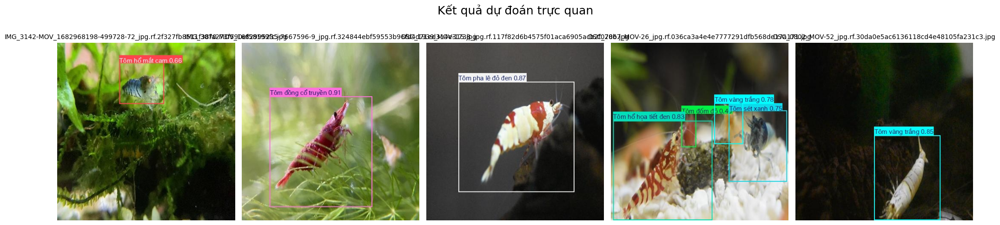

In [10]:
if experiment_save_dir and os.path.exists(experiment_save_dir) and data_config: 
    best_model_path = os.path.join(experiment_save_dir, 'weights', 'best.pt')
    if os.path.exists(best_model_path):
        model_pred = YOLO(best_model_path) # Tải mô hình tốt nhất
        
        # Chọn ảnh từ tập validation hoặc test để dự đoán
        # Ưu tiên tập validation nếu có, nếu không thì dùng tập test
        path_to_images_for_prediction = None
        if val_images_path and os.path.exists(val_images_path):
            path_to_images_for_prediction = val_images_path
            print(f"\nDự đoán trên một số ảnh từ tập validation ({path_to_images_for_prediction}) bằng mô hình {best_model_path}" )
        elif test_images_path and os.path.exists(test_images_path):
            path_to_images_for_prediction = test_images_path
            print(f"\nDự đoán trên một số ảnh từ tập test ({path_to_images_for_prediction}) bằng mô hình {best_model_path}" )
        else:
            print("Không tìm thấy thư mục ảnh validation hoặc test để thực hiện dự đoán trực quan.")
            path_to_images_for_prediction = None # Đảm bảo không chạy tiếp nếu không có ảnh
            
        if path_to_images_for_prediction:
            image_files_for_pred = [os.path.join(path_to_images_for_prediction, f) 
                                    for f in os.listdir(path_to_images_for_prediction) 
                                    if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
            
            if image_files_for_pred:
                num_pred_samples = min(5, len(image_files_for_pred)) # Số lượng ảnh mẫu để dự đoán
                sample_pred_images_paths = np.random.choice(image_files_for_pred, num_pred_samples, replace=False)
                
                # Thư mục để lưu ảnh có bounding box (trong thư mục của experiment hiện tại)
                # Define project_name if not already defined in this scope from training cell
                if 'project_name' not in globals() and 'project_name' not in locals():
                    project_name = 'YOLOv8_Shrimp_Detection' # Default if not found
                
                # The predict function will save to project/name.
                # We want to save it relative to the experiment_save_dir for better organization.
                # Let's define a specific project and name for these visualizations.
                vis_project_dir_base = os.path.join(experiment_save_dir, 'predictions_visualization')
                vis_experiment_name = 'samples'

                print(f"Ảnh dự đoán trực quan sẽ được lưu vào thư mục con bên trong: {vis_project_dir_base}" )
                
                # Bỏ comment khối try-except dưới đây để chạy dự đoán và hiển thị
                # print("LƯU Ý: BỎ COMMENT KHỐI TRY-EXCEPT DƯỚI ĐÂY ĐỂ CHẠY DỰ ĐOÁN TRỰC QUAN.")
                try:
                    # Thực hiện dự đoán, save=True để lưu ảnh kết quả
                    # conf là ngưỡng tin cậy, iou là ngưỡng IoU cho NMS
                    prediction_output = model_pred.predict(
                        source=list(sample_pred_images_paths), 
                        save=True, 
                        project=vis_project_dir_base, # Thư mục gốc cho project predict
                        name=vis_experiment_name, # Tên thư mục con trong project predict
                        exist_ok=True, 
                        conf=0.35, # Ngưỡng tin cậy, có thể điều chỉnh
                        iou=0.5    # Ngưỡng IoU cho NMS, có thể điều chỉnh
                    )
                    print("Đã thực hiện dự đoán và lưu ảnh.")
                    
                    # Đường dẫn tới thư mục chứa các ảnh đã được vẽ bounding box
                    # YOLO lưu vào project/name/image_name.jpg
                    saved_pred_image_folder = os.path.join(vis_project_dir_base, vis_experiment_name)
                    
                    if os.path.exists(saved_pred_image_folder):
                        predicted_image_files_display = [os.path.join(saved_pred_image_folder, f) 
                                                       for f in os.listdir(saved_pred_image_folder) 
                                                       if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
                        if predicted_image_files_display:
                            # Determine number of rows for subplot dynamically
                            cols_subplot = num_pred_samples
                            rows_subplot = (len(predicted_image_files_display) + cols_subplot - 1) // cols_subplot
                            
                            plt.figure(figsize=(20, 5 * rows_subplot if rows_subplot > 0 else 5)) # Adjust height based on rows
                            plt.suptitle("Kết quả dự đoán trực quan", fontsize=18)
                            for i, img_f_path in enumerate(predicted_image_files_display):
                                # if i >= num_pred_samples * 2 : break # Limit removed to show all saved samples
                                plt.subplot(rows_subplot , cols_subplot, i + 1)
                                plt.imshow(Image.open(img_f_path))
                                plt.title(os.path.basename(img_f_path), fontsize=10)
                                plt.axis('off')
                            plt.tight_layout(rect=[0, 0, 1, 0.95])
                            plt.show()
                        else:
                            print(f"Không tìm thấy file ảnh nào trong thư mục dự đoán đã lưu: {saved_pred_image_folder}" )
                    else:
                        print(f"Không tìm thấy thư mục ảnh dự đoán đã lưu: {saved_pred_image_folder}" )
                        print("Có thể cần kiểm tra lại đường dẫn hoặc quá trình predict có thực sự lưu ảnh không.")
                        # In ra nội dung của prediction_output để debug
                        # for i, r in enumerate(prediction_output):
                        #    print(f"Kết quả cho ảnh {sample_pred_images_paths[i]}:")
                        #    r.show() # Hiển thị trực tiếp nếu môi trường hỗ trợ
                        #    r.print() # In thông tin box
                            
                except Exception as e:
                    print(f"LỖI trong quá trình dự đoán ảnh mẫu hoặc hiển thị: {e}" )
                    import traceback
                    traceback.print_exc()
            else:
                print(f"Không có ảnh trong thư mục được chọn để dự đoán: {path_to_images_for_prediction}" )
    else:
        print(f"Không tìm thấy mô hình best.pt tại {best_model_path}. Không thể thực hiện dự đoán trực quan.")
else:
    print("Không thể thực hiện dự đoán trực quan: thiếu thư mục kết quả huấn luyện (`experiment_save_dir`) hoặc cấu hình data (`data_config`). Chạy lại các cell trước đó.")

### 3.4. Thảo luận (Discussion)
Trong phần này, chúng ta sẽ phân tích sâu hơn về các kết quả thu được.

**Hiệu suất tổng thể của mô hình:**
- Dựa trên các chỉ số mAP@0.5 và mAP@0.5:0.95, mô hình đạt được hiệu suất như thế nào? (Ví dụ: `mAP@0.5 = 0.XX`, `mAP@0.5:0.95 = 0.YY`). So sánh với các benchmark nếu có.
- Các giá trị Precision và Recall cho thấy điều gì về khả năng phát hiện đúng và không bỏ sót đối tượng của mô hình?

**Phân tích theo từng lớp (nếu cần):**
- Xem xét ma trận nhầm lẫn: Có lớp nào bị nhầm lẫn nhiều với các lớp khác không? Lớp nào mô hình nhận diện tốt nhất/kém nhất?
- Nguyên nhân có thể của sự nhầm lẫn hoặc hiệu suất kém ở một số lớp (ví dụ: sự tương đồng về hình thái giữa các loại tôm, số lượng mẫu ít cho một số lớp, chất lượng ảnh không đồng đều).

**Phân tích các trường hợp dự đoán sai/bỏ sót:**
- Quan sát các hình ảnh dự đoán trực quan: Các lỗi thường gặp là gì (ví dụ: phát hiện sai vị trí, bỏ sót tôm nhỏ/bị che khuất, nhầm lẫn giữa các loại tôm có hình dáng tương tự)?
- Các yếu tố nào trong ảnh có thể gây khó khăn cho mô hình (ví dụ: ánh sáng phức tạp, nền nhiễu, tôm ở các tư thế lạ)?

**Điểm mạnh và yếu của mô hình:**
- **Điểm mạnh:** (Ví dụ: tốc độ phát hiện nhanh, khả năng nhận diện tốt các loại tôm phổ biến, dễ dàng huấn luyện lại với dữ liệu mới).
- **Điểm yếu:** (Ví dụ: độ chính xác có thể giảm với các loại tôm hiếm hoặc có hình dạng đặc biệt, nhạy cảm với chất lượng ảnh đầu vào, cần cải thiện khả năng phân biệt các lớp tương đồng).

**So sánh (nếu có):**
- Nếu có các nghiên cứu tương tự về nhận diện tôm bằng YOLO hoặc các mô hình khác, có thể so sánh sơ bộ về phương pháp và kết quả.
- So sánh với kết quả từ bài báo gốc (Penaeus vannamei) nếu có sự tương đồng về phương pháp luận, mặc dù bộ dữ liệu và số lớp khác nhau.

**Đề xuất các hướng cải thiện tiềm năng:**
- **Dữ liệu:** Thu thập thêm dữ liệu cho các lớp có số lượng mẫu ít, cải thiện chất lượng nhãn, áp dụng các kỹ thuật tăng cường dữ liệu (augmentation) nâng cao hơn.
- **Mô hình:** Thử nghiệm các biến thể YOLOv8 khác (lớn hơn để tăng độ chính xác, hoặc nhỏ hơn để tăng tốc độ nếu cần). Tinh chỉnh các siêu tham số huấn luyện (learning rate, optimizer, số epochs,...).
- **Hậu xử lý:** Tinh chỉnh ngưỡng tin cậy (confidence threshold) và ngưỡng IoU cho Non-Maximum Suppression (NMS).
- **Kiến trúc:** Nếu vấn đề phức tạp, có thể xem xét các kỹ thuật như ensemble learning hoặc kết hợp với các module xử lý ảnh khác.

## 4. Kết luận (Conclusions)

Báo cáo này đã trình bày quá trình xây dựng và đánh giá một mô hình phát hiện và phân loại tôm sử dụng YOLOv8 trên bộ dữ liệu tùy chỉnh.

**Tóm tắt kết quả chính:**
- Mô hình YOLOv8 (`{model_variant}`) đã được huấn luyện thành công trên bộ dữ liệu gồm `{num_classes}` lớp tôm.
- Các chỉ số hiệu suất chính thu được là: mAP@0.5 = [điền giá trị], mAP@0.5:0.95 = [điền giá trị], Precision = [điền giá trị], Recall = [điền giá trị] (lấy từ kết quả huấn luyện hoặc đánh giá trên tập test).
- (Mô tả thêm về các phát hiện quan trọng từ phần thảo luận).

**Đáp ứng mục tiêu:**
- Mô hình đã cho thấy khả năng [mô tả khả năng, ví dụ: 'khá tốt', 'trung bình', 'cần cải thiện nhiều'] trong việc phát hiện và phân loại các loại tôm trong bộ dữ liệu thử nghiệm.
- (Nêu rõ mục tiêu nào đã đạt được và mục tiêu nào cần tiếp tục hoàn thiện).

**Khả năng ứng dụng thực tế:**
- Với hiệu suất hiện tại, mô hình [có thể/chưa thể/cần cải thiện để] được ứng dụng trong [nêu các ứng dụng tiềm năng, ví dụ: hệ thống kiểm đếm tự động, hỗ trợ phân loại sơ bộ trong nhà máy chế biến, công cụ cho người nuôi tôm,...].
- Những yếu tố cần xem xét khi triển khai thực tế (ví dụ: yêu cầu về tốc độ, độ chính xác, khả năng chạy trên thiết bị cụ thể).

**Đề xuất các bước tiếp theo:**
- **Cải thiện mô hình:** Thực hiện các đề xuất đã nêu trong phần Thảo luận (ví dụ: tăng cường dữ liệu, tinh chỉnh siêu tham số, thử nghiệm mô hình lớn hơn).
- **Tối ưu hóa cho triển khai:** Nếu mô hình đạt yêu cầu, có thể tiến hành tối ưu hóa (ví dụ: chuyển đổi sang định dạng ONNX, TensorRT) để tăng tốc độ suy luận trên các thiết bị mục tiêu.
- **Phát triển ứng dụng:** Xây dựng giao diện người dùng hoặc tích hợp mô hình vào một hệ thống hoàn chỉnh để kiểm tra trong môi trường thực tế.
- **Mở rộng nghiên cứu:** (Ví dụ: áp dụng cho các loài thủy sản khác, kết hợp thêm các thông tin khác ngoài hình ảnh để tăng độ chính xác).

## 5. Phụ lục (Appendix - Tùy chọn)

### 5.1. Lưu trữ và Xuất mô hình (Model Saving and Export)

In [11]:
if experiment_save_dir and os.path.exists(experiment_save_dir):
    best_model_path = os.path.join(experiment_save_dir, 'weights', 'best.pt')
    if os.path.exists(best_model_path):
        print(f"Mô hình tốt nhất (.pt) được lưu tại: {best_model_path}")
        model_export = YOLO(best_model_path) # Tải lại mô hình để export
        
        # Bỏ comment khối try-except dưới đây để xuất mô hình sang định dạng khác (ví dụ ONNX)
        # print("LƯU Ý: BỎ COMMENT KHỐI TRY-EXCEPT DƯỚI ĐÂY ĐỂ XUẤT MODEL SANG ONNX.")
        # try:
        #     # Xuất sang định dạng ONNX
        #     # imgsz cần khớp với lúc huấn luyện hoặc kích thước đầu vào mong muốn khi triển khai
        #     # opset có thể cần điều chỉnh tùy theo môi trường triển khai
        #     onnx_path = model_export.export(format='onnx', imgsz=img_size, opset=12) 
        #     print(f"Mô hình đã được xuất sang ONNX tại: {onnx_path}")
        # except Exception as e:
        #     print(f"LỖI khi xuất mô hình sang ONNX: {e}" )
    else:
        print(f"Không tìm thấy mô hình best.pt tại {best_model_path} để xuất.")
else:
    print("Không có thư mục kết quả huấn luyện (`experiment_save_dir`) để tìm mô hình. Chạy lại cell huấn luyện hoặc đặt đường dẫn thủ công.")

Mô hình tốt nhất (.pt) được lưu tại: YOLOv8_Shrimp_Detection/yolov8n_customData_e50_b16_img640/weights/best.pt


### 5.2. Hướng dẫn sử dụng mô hình đã huấn luyện để dự đoán trên ảnh mới


--- Ví dụ dự đoán trên ảnh mới ---
Sử dụng ảnh mẫu: /kaggle/input/datatom/test/images/DSC_1939_MOV-1165_jpg.rf.44d953fe3f41833fc1185e9f3d5af092.jpg
Thực hiện dự đoán cho ảnh: /kaggle/input/datatom/test/images/DSC_1939_MOV-1165_jpg.rf.44d953fe3f41833fc1185e9f3d5af092.jpg
Ngưỡng tin cậy: 0.4, Ngưỡng IoU: 0.45

image 1/1 /kaggle/input/datatom/test/images/DSC_1939_MOV-1165_jpg.rf.44d953fe3f41833fc1185e9f3d5af092.jpg: 640x640 1 Tôm pha lê đỏ đen, 7.1ms
Speed: 2.5ms preprocess, 7.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)
Results saved to predictions_on_new_data/single_pred_DSC_1939_MOV-1165_jpg.rf.44d953fe3f41833fc1185e9f3d5af092
Đã lưu ảnh dự đoán vào thư mục con trong: predictions_on_new_data/single_pred_DSC_1939_MOV-1165_jpg.rf.44d953fe3f41833fc1185e9f3d5af092
Hiển thị ảnh dự đoán:


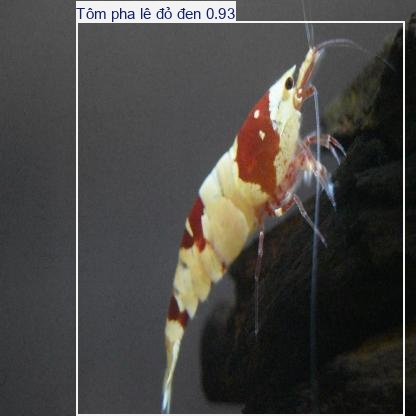


Thông tin các đối tượng được phát hiện:
  - Lớp: Tôm pha lê đỏ đen, Độ tin cậy: 0.928, Bounding Box (xyxy): [76.4, 21.7, 404.7, 415.8]


In [12]:
def predict_single_new_image(model_path_to_load, new_image_path, output_directory='predictions_on_new_data', conf_thresh=0.25, iou_thresh=0.45):
    if not os.path.exists(model_path_to_load):
        print(f"Lỗi: Không tìm thấy mô hình tại {model_path_to_load}" )
        return
    if not os.path.exists(new_image_path):
        print(f"Lỗi: Không tìm thấy ảnh tại {new_image_path}" )
        return
    
    loaded_model = YOLO(model_path_to_load)
    # os.makedirs(output_directory, exist_ok=True) # predict tự tạo thư mục
    
    print(f"Thực hiện dự đoán cho ảnh: {new_image_path}" )
    print(f"Ngưỡng tin cậy: {conf_thresh}, Ngưỡng IoU: {iou_thresh}")
    
    # Bỏ comment khối try-except dưới đây để chạy dự đoán trên ảnh mới
    # print("LƯU Ý: BỎ COMMENT KHỐI TRY-EXCEPT DƯỚI ĐÂY ĐỂ CHẠY DỰ ĐOÁN TRÊN ẢNH MỚI.")
    try:
        # Thực hiện dự đoán, save=True để lưu ảnh kết quả
        # project và name để kiểm soát thư mục lưu trữ
        # Define a unique name for this prediction run to avoid overwriting if called multiple times
        prediction_run_name = f'single_pred_{os.path.splitext(os.path.basename(new_image_path))[0]}'

        prediction_results_list = loaded_model.predict(
            source=new_image_path, 
            save=True, 
            project=output_directory, 
            name=prediction_run_name, # Use a more dynamic name
            exist_ok=True, 
            conf=conf_thresh,
            iou=iou_thresh
        )
        
        if prediction_results_list:
            saved_predicted_img_folder = os.path.join(output_directory, prediction_run_name)
            print(f"Đã lưu ảnh dự đoán vào thư mục con trong: {saved_predicted_img_folder}" )
            
            # Hiển thị ảnh kết quả (đường dẫn có thể cần điều chỉnh dựa trên cách YOLO lưu)
            # YOLO thường lưu vào project/name/image_name.jpg
            # The actual saved image name might be the same as the input, or modified if it's not unique.
            # Let's list files in the directory to be sure.
            if os.path.exists(saved_predicted_img_folder):
                saved_files = [f for f in os.listdir(saved_predicted_img_folder) if f.lower().endswith(('.jpg', '.png', '.jpeg'))]
                if saved_files:
                    saved_predicted_img_path = os.path.join(saved_predicted_img_folder, saved_files[0]) # Display the first saved image
                    print("Hiển thị ảnh dự đoán:")
                    display(Image.open(saved_predicted_img_path))
                else:
                    print(f"Không tìm thấy file ảnh nào trong thư mục dự đoán đã lưu: {saved_predicted_img_folder}")
            else:
                print(f"Không tìm thấy thư mục ảnh dự đoán đã lưu: {saved_predicted_img_folder}, kiểm tra lại đường dẫn.")
            
            # In thông tin các bounding box được phát hiện
            print("\nThông tin các đối tượng được phát hiện:")
            for res_item in prediction_results_list: # Lặp qua các kết quả (thường là 1 cho một ảnh)
                boxes_data = res_item.boxes # Đối tượng Boxes object
                if len(boxes_data) == 0:
                    print("  Không phát hiện đối tượng nào với ngưỡng hiện tại.")
                for box_item in boxes_data:
                    class_id_pred = int(box_item.cls[0])
                    class_name_pred = loaded_model.names[class_id_pred] if loaded_model.names and 0 <= class_id_pred < len(loaded_model.names) else f'ClassID {class_id_pred}'
                    confidence_pred = float(box_item.conf[0])
                    xyxy_coords = box_item.xyxy[0].tolist() # tọa độ [x1, y1, x2, y2]
                    print(f"  - Lớp: {class_name_pred}, Độ tin cậy: {confidence_pred:.3f}, Bounding Box (xyxy): [{', '.join(map(lambda x: f'{x:.1f}', xyxy_coords))}]")
        else:
            print("Không có kết quả trả về từ hàm predict.")
    except Exception as e:
        print(f"LỖI trong quá trình dự đoán ảnh mới: {e}" )
        import traceback
        traceback.print_exc()

# Ví dụ sử dụng (bỏ comment và thay đổi đường dẫn nếu cần):
print("\n--- Ví dụ dự đoán trên ảnh mới ---")
# Ensure experiment_save_dir is defined (e.g., from training cell or loaded manually)
if 'experiment_save_dir' not in globals() or not experiment_save_dir:
    # Attempt to reconstruct if not set (e.g., notebook opened and this cell run standalone)
    print("Biến 'experiment_save_dir' chưa được định nghĩa. Thử tải lại từ cấu hình huấn luyện mặc định.")
    temp_model_variant_pv = 'yolov8s.pt' # Must match your training
    temp_epochs_pv = 50
    temp_batch_size_pv = 16
    temp_img_size_pv = 640
    if 'project_name' not in globals(): project_name_pv = "YOLOv8_Shrimp_Detection" 
    else: project_name_pv = project_name

    temp_experiment_name_pv = f'{os.path.splitext(temp_model_variant_pv)[0]}_customData_e{temp_epochs_pv}_b{temp_batch_size_pv}_img{temp_img_size_pv}'
    potential_exp_dir_pv = os.path.join('runs', 'train', project_name_pv, temp_experiment_name_pv)
    if os.path.exists(potential_exp_dir_pv):
        experiment_save_dir = potential_exp_dir_pv
        print(f"Đã đặt 'experiment_save_dir' thành: {experiment_save_dir}")
    else:
        print(f"Không tìm thấy thư mục thí nghiệm mặc định: {potential_exp_dir_pv}. Cần chạy cell huấn luyện trước.")


if experiment_save_dir and os.path.exists(os.path.join(experiment_save_dir, 'weights', 'best.pt')):
    path_to_my_trained_model = os.path.join(experiment_save_dir, 'weights', 'best.pt')
    # Bạn cần cung cấp đường dẫn đến một ảnh mới để thử nghiệm
    # Ví dụ: lấy một ảnh từ tập test nếu có
    # Ensure test_images_path is defined (e.g. from data loading cell)
    if 'test_images_path' not in globals() or not test_images_path:
        print("Biến 'test_images_path' chưa được định nghĩa. Kiểm tra cell đọc data.yaml.")
        # Attempt to reconstruct test_images_path if data_config is available
        if 'data_config' in globals() and data_config and data_config.get('test'):
            test_images_path = data_config.get('test') # This should be an absolute path from cell 8
            print(f"Đã đặt 'test_images_path' từ data_config: {test_images_path}")
        else:
            print("Không thể tự động xác định 'test_images_path'.")


    if test_images_path and os.path.exists(test_images_path):
        all_test_images = [os.path.join(test_images_path, f) for f in os.listdir(test_images_path) if f.lower().endswith(('.jpg','.png','.jpeg'))]
        if all_test_images:
            path_to_my_sample_new_image = all_test_images[0] # Lấy ảnh đầu tiên từ tập test
            print(f"Sử dụng ảnh mẫu: {path_to_my_sample_new_image}")
            predict_single_new_image(path_to_my_trained_model, path_to_my_sample_new_image, conf_thresh=0.4)
            # print("Bỏ comment dòng trên (predict_single_new_image...) để chạy ví dụ này.") # Already uncommented
        else:
            print("Không tìm thấy ảnh nào trong thư mục test để làm ví dụ.")
    else:
        print("Không có thư mục test images ('test_images_path') hoặc đường dẫn không tồn tại để lấy ảnh ví dụ. Hãy cung cấp đường dẫn ảnh thủ công.")
        # path_to_my_sample_new_image = 'ĐƯỜNG_DẪN_ĐẾN_ẢNH_CỦA_BẠN.jpg' # THAY ĐỔI ĐƯỜNG DẪN NÀY
        # if os.path.exists(path_to_my_sample_new_image):
        #     predict_single_new_image(path_to_my_trained_model, path_to_my_sample_new_image)
        # else:
        #     print(f"Ảnh thử nghiệm mới không tồn tại: {path_to_my_sample_new_image}" )
else:
    print("Chưa có mô hình đã huấn luyện (`best.pt` trong `experiment_save_dir`) để thực hiện dự đoán. Chạy lại cell huấn luyện hoặc đặt đường dẫn đúng.")
    if not experiment_save_dir : print("  Lý do: experiment_save_dir is None or empty.")
    elif not os.path.exists(os.path.join(experiment_save_dir, 'weights', 'best.pt')): print(f"  Lý do: best.pt không tồn tại trong {os.path.join(experiment_save_dir, 'weights')}")

## 6. Lưu và Xuất Model (Cuối File)

Cell này dùng để:
1. Xác nhận lại đường dẫn của mô hình `best.pt` (đã được lưu tự động sau quá trình huấn luyện).
2. Xuất mô hình `best.pt` sang định dạng `.onnx`, hữu ích cho việc triển khai trên nhiều nền tảng khác nhau.

Hãy đảm bảo bạn đã chạy cell huấn luyện (thường là Cell 16) để có các biến `experiment_save_dir`, `img_size` và tệp `best.pt` đã được tạo.

In [13]:
# This cell should be run after the training is complete and 'best.pt' is generated.
# It relies on 'experiment_save_dir' and 'img_size' being defined in previous cells (e.g., Cell 16).

import os
from ultralytics import YOLO
import traceback # Should be imported in earlier cells

print("\n--- Phần bổ sung: Lưu và Xuất Model (Cuối File) ---")

can_proceed = True
# 1. Kiểm tra các biến cần thiết
if 'experiment_save_dir' not in globals() or not experiment_save_dir:
    print("LỖI: Biến 'experiment_save_dir' chưa được định nghĩa. Hãy chạy cell huấn luyện (Cell 16) trước.")
    can_proceed = False
else:
    # Chỉ kiểm tra img_size nếu experiment_save_dir tồn tại
    if 'img_size' not in globals() or not img_size:
        print("LỖI: Biến 'img_size' chưa được định nghĩa. Hãy chạy cell huấn luyện (Cell 16) nơi nó được thiết lập.")
        can_proceed = False

if can_proceed:
    current_experiment_save_dir = experiment_save_dir
    current_img_size = img_size # Đã kiểm tra sự tồn tại
    
    print(f"Sử dụng thư mục thí nghiệm: {current_experiment_save_dir}")
    print(f"Sử dụng kích thước ảnh (imgsz) cho export: {current_img_size}")

    # 2. Xử lý model .pt (xác nhận sự tồn tại)
    best_model_pt_path = os.path.join(current_experiment_save_dir, 'weights', 'best.pt')
    
    if os.path.exists(best_model_pt_path):
        print(f"Mô hình .pt (best.pt) đã được lưu tự động tại: {best_model_pt_path}")

        # 3. Xuất model sang .onnx
        print(f"\nBắt đầu quá trình xuất mô hình từ '{best_model_pt_path}' sang định dạng ONNX...")
        try:
            model_to_export = YOLO(best_model_pt_path)
            
            # opset=12 là một lựa chọn phổ biến, có thể cần điều chỉnh tùy theo môi trường đích
            onnx_export_path = model_to_export.export(format='onnx', imgsz=current_img_size, opset=12) 
            print(f"Mô hình đã được xuất thành công sang ONNX tại: {onnx_export_path}")
            
        except Exception as e:
            print(f"LỖI trong quá trình xuất mô hình sang ONNX: {e}")
            traceback.print_exc()
    else:
        print(f"LỖI: Không tìm thấy tệp 'best.pt' tại '{os.path.join(current_experiment_save_dir, 'weights')}'")
        print("Vui lòng đảm bảo quá trình huấn luyện đã hoàn tất và tạo ra tệp 'best.pt'.")
else:
    print("Không thể tiến hành do thiếu 'experiment_save_dir' hoặc 'img_size'. Kiểm tra lại các cell trước đó, đặc biệt là cell huấn luyện.")

print("\n--- Hoàn tất phần bổ sung Lưu và Xuất Model ---")


--- Phần bổ sung: Lưu và Xuất Model (Cuối File) ---
Sử dụng thư mục thí nghiệm: YOLOv8_Shrimp_Detection/yolov8n_customData_e50_b16_img640
Sử dụng kích thước ảnh (imgsz) cho export: 640
Mô hình .pt (best.pt) đã được lưu tự động tại: YOLOv8_Shrimp_Detection/yolov8n_customData_e50_b16_img640/weights/best.pt

Bắt đầu quá trình xuất mô hình từ 'YOLOv8_Shrimp_Detection/yolov8n_customData_e50_b16_img640/weights/best.pt' sang định dạng ONNX...
Ultralytics 8.3.137 🚀 Python-3.11.11 torch-2.6.0+cu124 CPU (Intel Xeon 2.00GHz)
💡 ProTip: Export to OpenVINO format for best performance on Intel CPUs. Learn more at https://docs.ultralytics.com/integrations/openvino/
Model summary (fused): 72 layers, 3,008,183 parameters, 0 gradients, 8.1 GFLOPs

PyTorch: starting from 'YOLOv8_Shrimp_Detection/yolov8n_customData_e50_b16_img640/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 17, 8400) (6.0 MB)
requirements: Ultralytics requirements ['onnxslim>=0.1.53', 'onnxruntime-gpu'] 